In [1]:
import scanpy as sc
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import matplotlib as mpl

In [2]:
df=pd.read_csv('~/cellxgene/r100/FinalReport_PerCellAnalysis.csv')

In [3]:
df

,Cell No.,Nucleus location (X),Nucleus location (Y),Nucleus perimeter,ALD1AH1,KCNT2,HIGD1B,ALD1AH2,PDGFRB,CLDN5,...,KCNJ8,VEGFC,IL1R1,TAGLN,MFSD2A,RARA,TMEM132C,ACKR1,RGS16,MECOM
0,1,4708,444371,793.6,1,0,0,9,12,2,...,0,0,34,25,31,12,0,2,7,0
1,2,3630,447522,476.6,0,1,0,0,0,0,...,0,0,1,2,0,0,0,0,1,0
2,3,1519,444432,484.6,0,0,0,3,2,0,...,0,0,0,1,0,1,0,1,0,0
3,4,4602,447108,409.3,0,0,0,0,0,1,...,0,0,0,0,0,1,1,0,0,0
4,5,1062,444070,455.3,0,0,0,2,0,0,...,0,1,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31950,31951,40131,442639,184.4,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
31951,31952,43825,441232,177.2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
31952,31953,39627,441354,134.1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
31953,31954,40360,441450,105.9,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [4]:
df.iloc[:,  :]
adata = sc.AnnData(df.iloc[:, 4:])
adata.obs = df.iloc[:,: 4]

/home/chang/miniconda3/envs/venv/lib/python3.7/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [5]:
adata.obs.columns = ['Cell No.', 'x_pos', 'y_pos', 'perimeter']

In [6]:
adata.obs['n_counts']  = adata.X.sum(axis=1)
adata.obs['n_genes'] = (adata.X > 0).sum(axis=1)

In [7]:
adata

AnnData object with n_obs × n_vars = 31955 × 18
    obs: 'Cell No.', 'x_pos', 'y_pos', 'perimeter', 'n_counts', 'n_genes'

In [8]:
adata=adata[adata.obs.n_counts != 0 ]

In [9]:
adata.obs['log_counts'] = np.log10(adata.obs['n_counts'])

Trying to set attribute `.obs` of view, copying.


In [10]:
#adata.var_names
#sc.pl.violin(adata, keys=adata.var_names, rotation=45)

In [11]:
adata = adata[adata.obs['perimeter'] < 1000]
adata

View of AnnData object with n_obs × n_vars = 21235 × 18
    obs: 'Cell No.', 'x_pos', 'y_pos', 'perimeter', 'n_counts', 'n_genes', 'log_counts'

In [12]:
adata2=adata[adata.obs['n_counts'] > 10]
adata2

View of AnnData object with n_obs × n_vars = 3797 × 18
    obs: 'Cell No.', 'x_pos', 'y_pos', 'perimeter', 'n_counts', 'n_genes', 'log_counts'

In [13]:
#sc.pl.violin(adata2, keys=['n_counts','n_genes'], groupby='cell_type',rotation=45, save='cell_types.svg')

In [14]:
#sc.pl.violin(adata2, keys=['n_counts','n_genes'], groupby='cell_type2',rotation=45, save='cell_types2.svg')

In [15]:
sc.pp.log1p(adata2)
sc.pp.scale(adata2)

/home/chang/miniconda3/envs/venv/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:375: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


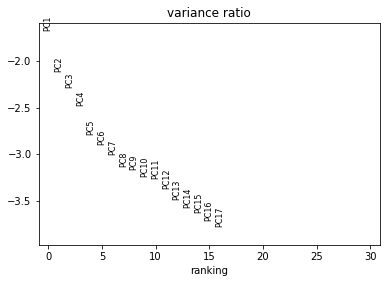

In [16]:
sc.tl.pca(adata2, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata2, log=True)

In [17]:
sc.pp.neighbors(adata2, n_neighbors=20, n_pcs=10)

In [38]:
sc.tl.leiden(adata2,
            resolution=.7)

In [39]:
sc.tl.umap(adata2)

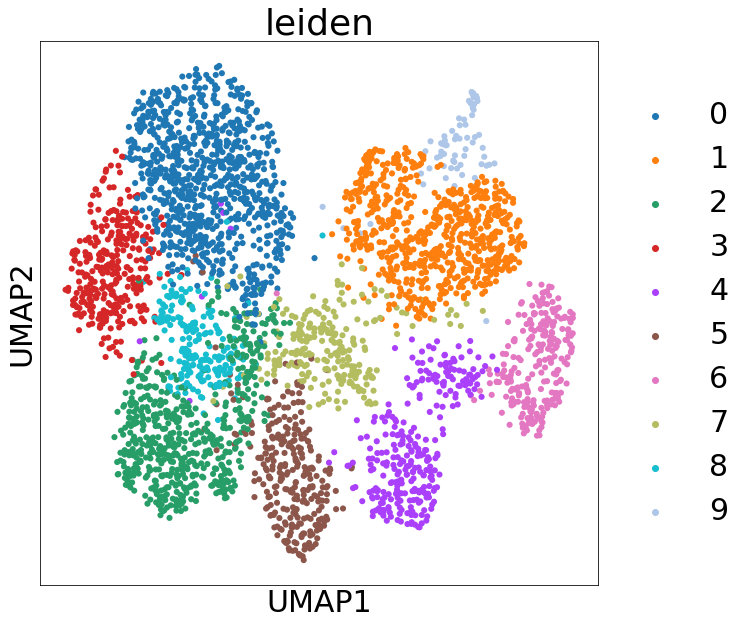

In [40]:
plt.rcParams['figure.figsize'] = 10, 10
plt.rcParams['font.size'] = 30

sc.pl.umap(adata2,
          color=['leiden'],
    size=150,
    ncols=4,
           add_outline=False
)

In [41]:
gene_list = adata.var_names.tolist()
gene_list#.append('spatial')
gene_list

['ALD1AH1',
 'KCNT2',
 'HIGD1B',
 'ALD1AH2',
 'PDGFRB',
 'CLDN5',
 'CCL19',
 'DCN',
 'KCNJ8',
 'VEGFC',
 'IL1R1',
 'TAGLN',
 'MFSD2A',
 'RARA',
 'TMEM132C',
 'ACKR1',
 'RGS16',
 'MECOM']

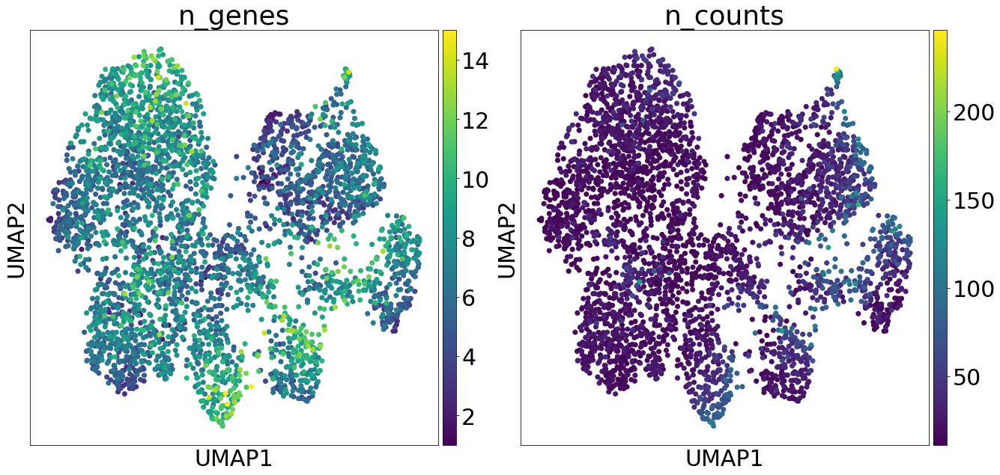

In [42]:
sc.pl.umap(adata2,
    color=['n_genes','n_counts'],
    size=200,
    ncols=2,)

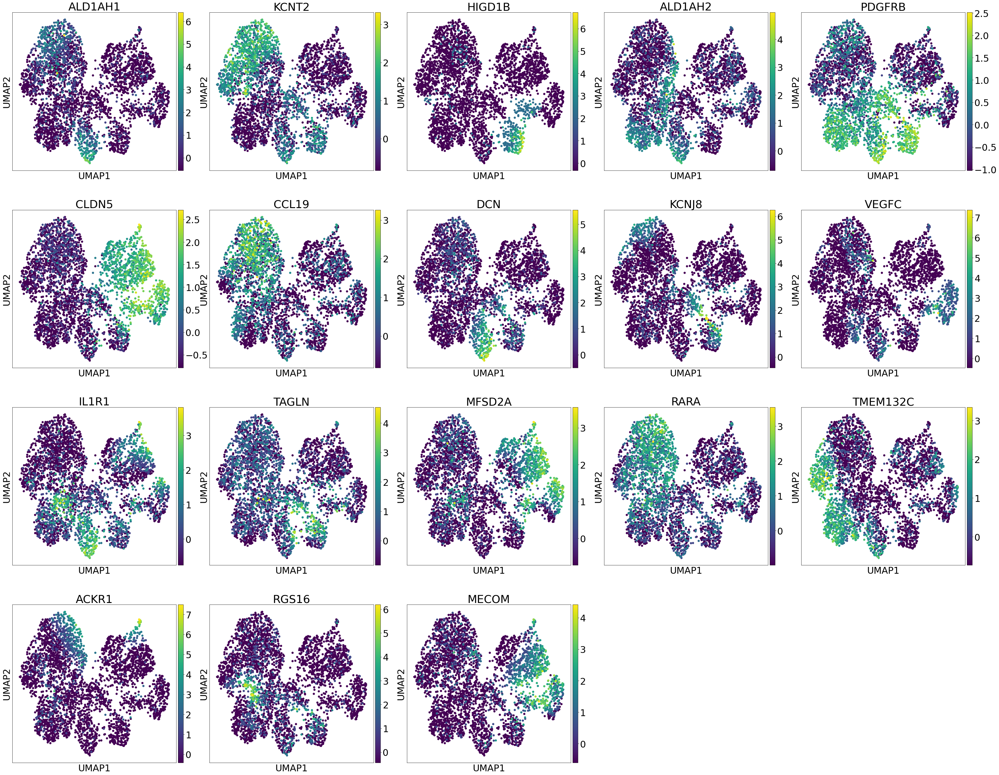

In [23]:
plt.rcParams['figure.figsize'] = 10, 10
plt.rcParams['font.size'] = 30


sc.pl.umap(adata2,
    color=gene_list,
    size=200,
    ncols=5,
    save='control_feature_umap.svg'
    #color_map = mpl.cm.cividis
)

In [68]:
old_to_new = {
    '0':'FBMC',
    '1':'EC',
    '2':'SMC',
    '3':'FBMC',
    '4':'PC',
    '5':'FB',
    '6':'EC',
    '7':'SMC',
    '8':'SMC',
    '9':'EC',
}
old_to_new2 = {
    '0':'FBMC1',
    '1':'Capillary/Venule',
    '2':'SMC6',
    '3':'FBMC2',
    '4':'PC',
    '5':'FB',
    '6':'Artery',
    '7':'SMC1',
    '8':'SMC2',
    '9':'Venous',
}
adata2.obs['cell_type'] = (
    adata2.obs['leiden']
    .map(old_to_new)
    .astype('category')
)
adata2.obs['cell_type2'] = (
    adata2.obs['leiden']
    .map(old_to_new2)
    .astype('category')
)
adata2.uns['cell_type_colors'] = ["#E69F00", "#56B4E9", "#009E73", "#F0E442", "#0072B2"]
adata2.uns['cell_type2_colors'] = ["#0072B2", "#56B4E9", "#CC79A7", "#F0E442", "#D55E00", "#009E73", "#E69F00", "#666666", "#AD7700", "#1C91D4"]

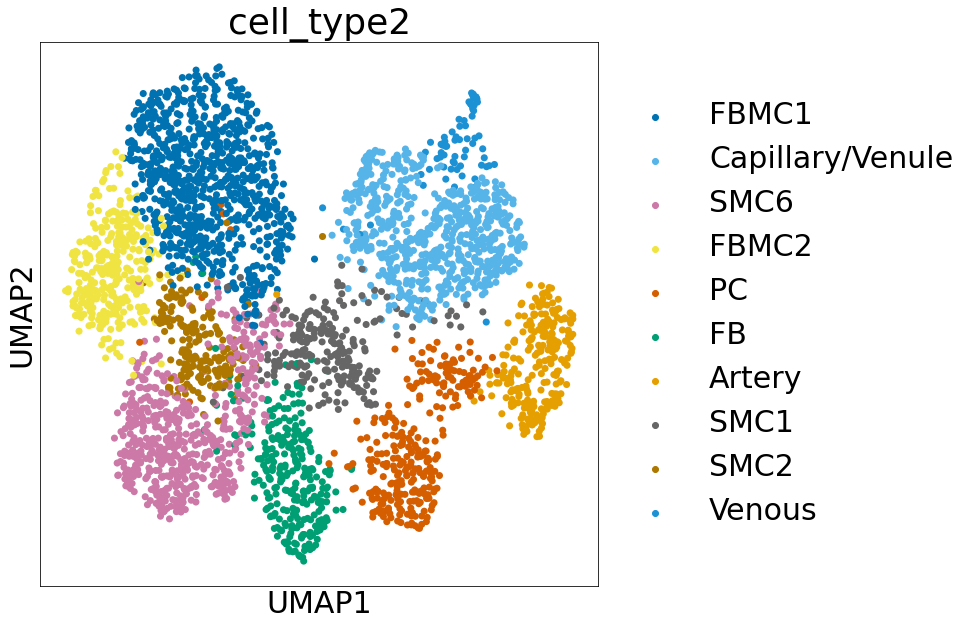

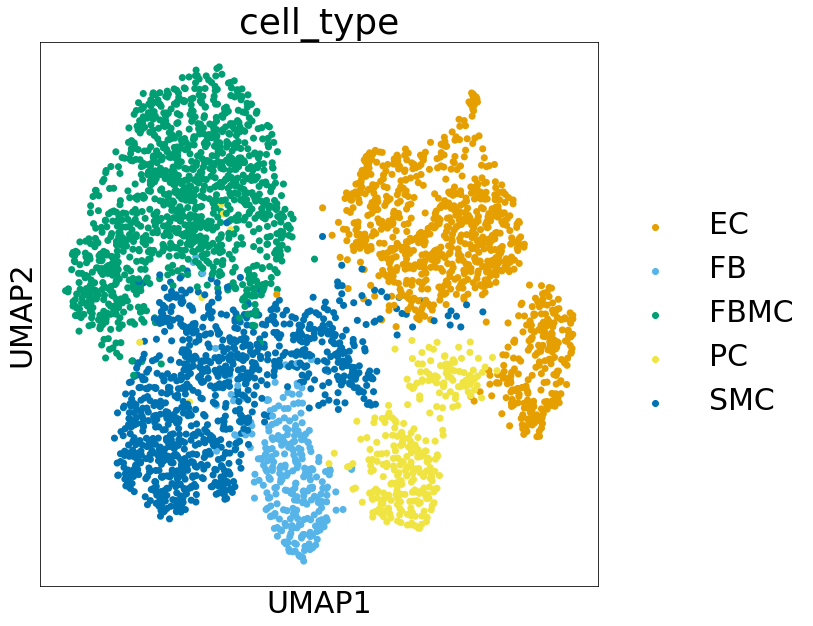

In [69]:
plt.rcParams['figure.figsize'] = 10, 10
plt.rcParams['font.size'] = 30


sc.pl.umap(adata2,
    color=['cell_type2'],
    size=200,
    #       add_outline=True
          # vmax=10,
)
sc.pl.umap(adata2,
    color=['cell_type'],
    size=200,
    #       add_outline=True
          # vmax=10,
)

In [70]:
df=pd.DataFrame(adata2.uns['cell_type_colors'],columns=['color'])
df['cell_type'] = adata2.obs.cell_type.cat.categories
df2 = pd.DataFrame(adata2.obs.cell_type)
df2=df2.merge(df, on='cell_type', how='left')
df2.index = adata2.obs.index
adata2.obs['color'] = df2['color']

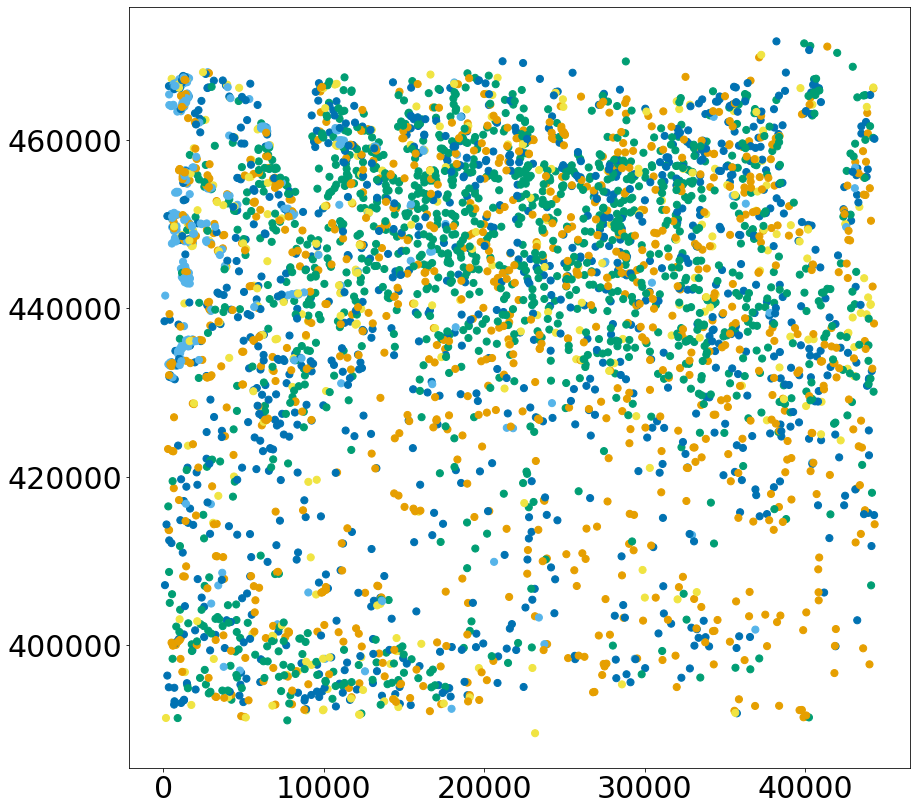

In [71]:
plt.figure(figsize=[14,14])

plt.scatter(x=adata2.obs.x_pos,
            y=adata2.obs.y_pos,
             c=adata2.obs.color,
            s=50,
           )

In [72]:
df=pd.DataFrame(adata2.uns['cell_type2_colors'],columns=['color'])
df['cell_type2'] = adata2.obs.cell_type2.cat.categories
df2 = pd.DataFrame(adata2.obs.cell_type2)
df2=df2.merge(df, on='cell_type2', how='left')
df2.index = adata2.obs.index
adata2.obs['color'] = df2['color']

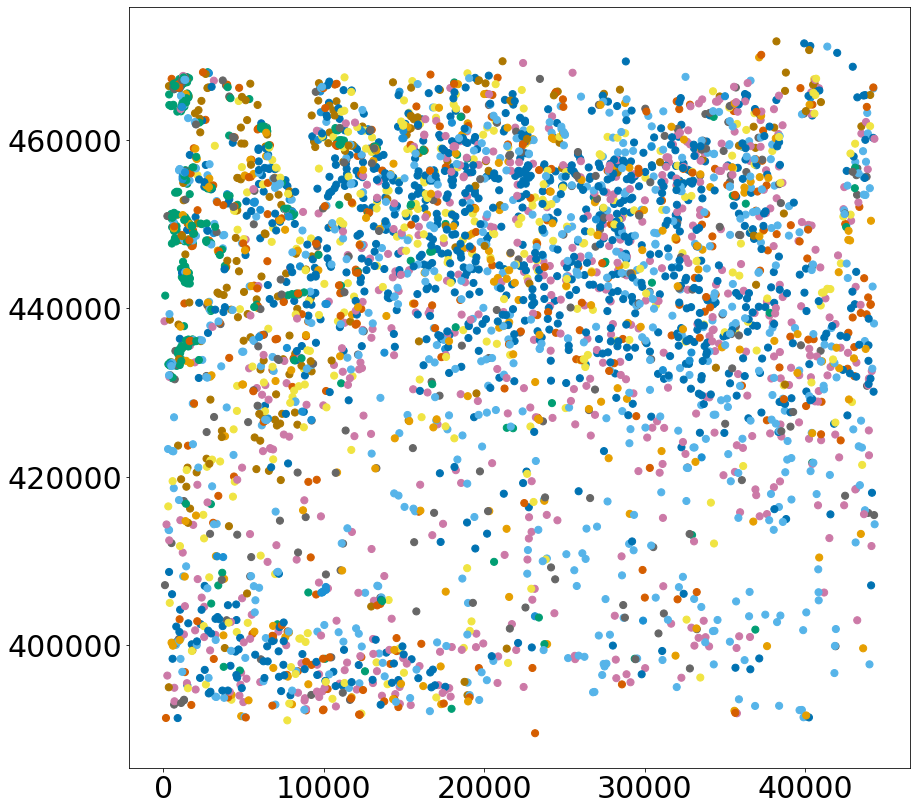

In [73]:
plt.figure(figsize=[14,14])


plt.scatter(x=adata2.obs.x_pos,
            y=adata2.obs.y_pos,
             c=adata2.obs.color,
            s=50,
           )

/home/chang/miniconda3/envs/venv/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'color' as categorical


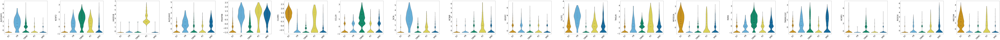

In [74]:
sc.pl.violin(adata2, keys=adata.var_names,groupby='cell_type', rotation=45)

In [75]:
adata2.var_names

Index(['ALD1AH1', 'KCNT2', 'HIGD1B', 'ALD1AH2', 'PDGFRB', 'CLDN5', 'CCL19',
       'DCN', 'KCNJ8', 'VEGFC', 'IL1R1', 'TAGLN', 'MFSD2A', 'RARA', 'TMEM132C',
       'ACKR1', 'RGS16', 'MECOM'],
      dtype='object')

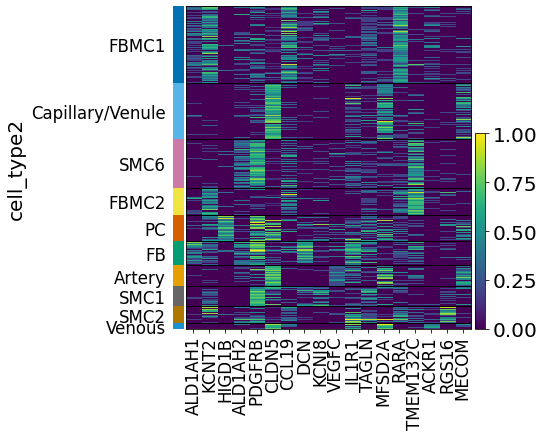

In [76]:
plt.rcParams['figure.figsize'] = 20, 20
plt.rcParams['font.size'] = 20
sc.pl.heatmap(adata2, adata2.var_names, groupby='cell_type2', swap_axes=False, standard_scale='var')

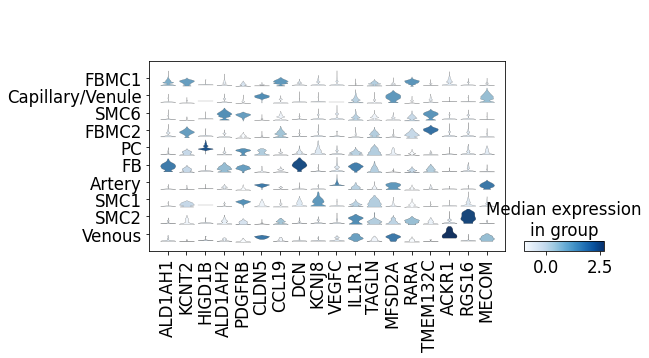

In [77]:
plt.rcParams['figure.figsize'] = 20, 20
plt.rcParams['font.size'] = 20
sc.pl.stacked_violin(adata2, adata2.var_names, groupby='cell_type2')

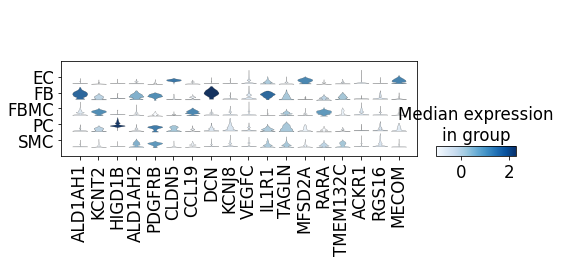

In [78]:
plt.rcParams['figure.figsize'] = 20, 20
plt.rcParams['font.size'] = 20
sc.pl.stacked_violin(adata2, adata2.var_names, groupby='cell_type')

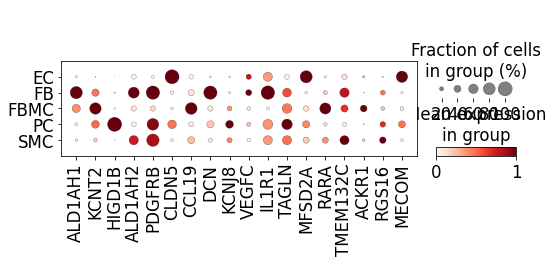

In [79]:
plt.rcParams['figure.figsize'] = 20, 20
plt.rcParams['font.size'] = 20
sc.pl.dotplot(adata2, adata2.var_names, groupby='cell_type', standard_scale='var')

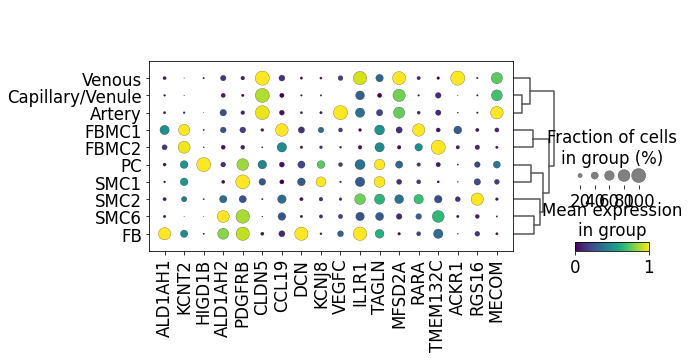

In [80]:
plt.rcParams['figure.figsize'] = 20, 20
plt.rcParams['font.size'] = 20
sc.tl.dendrogram(adata2, groupby='cell_type2')
sc.pl.dotplot(adata2, adata2.var_names, groupby='cell_type2', standard_scale='var', dendrogram=True, save='dendro_sub.svg', cmap = 'viridis')

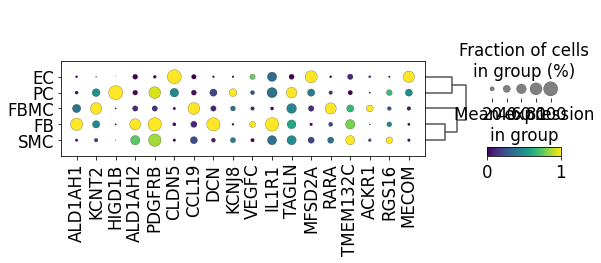

In [81]:
plt.rcParams['figure.figsize'] = 20, 20
plt.rcParams['font.size'] = 20
sc.tl.dendrogram(adata2, groupby='cell_type')
sc.pl.dotplot(adata2, adata2.var_names, groupby='cell_type', standard_scale='var', dendrogram=True,categories_order=['EC', 'PC', 'SMC', 'FB', 'FBMC'], save='dendro_cell.svg', cmap = 'viridis')

In [82]:
subset = adata2[adata2.obs['cell_type2'].isin(["Venous","Artery","Capillary/Venule"])]
#df=pd.DataFrame(subset.uns['cell_type2_colors'],columns=['color'])
#df['cell_type2'] = subset.obs.cell_type2.cat.categories
df2 = pd.DataFrame(subset.obs.cell_type2)
#df2=df2.merge(df, on='cell_type2', how='left')

In [83]:
df2

,cell_type2
5,Artery
9,Capillary/Venule
23,Artery
35,Venous
47,Artery
...,...
31760,Artery
31764,Capillary/Venule
31774,Artery
31783,Capillary/Venule


/home/chang/miniconda3/envs/venv/lib/python3.7/site-packages/seaborn/distributions.py:1185: UserWarning: The following kwargs were not used by contour: 'linewidth'
  **contour_kws,


<AxesSubplot:xlabel='x_pos', ylabel='y_pos'>

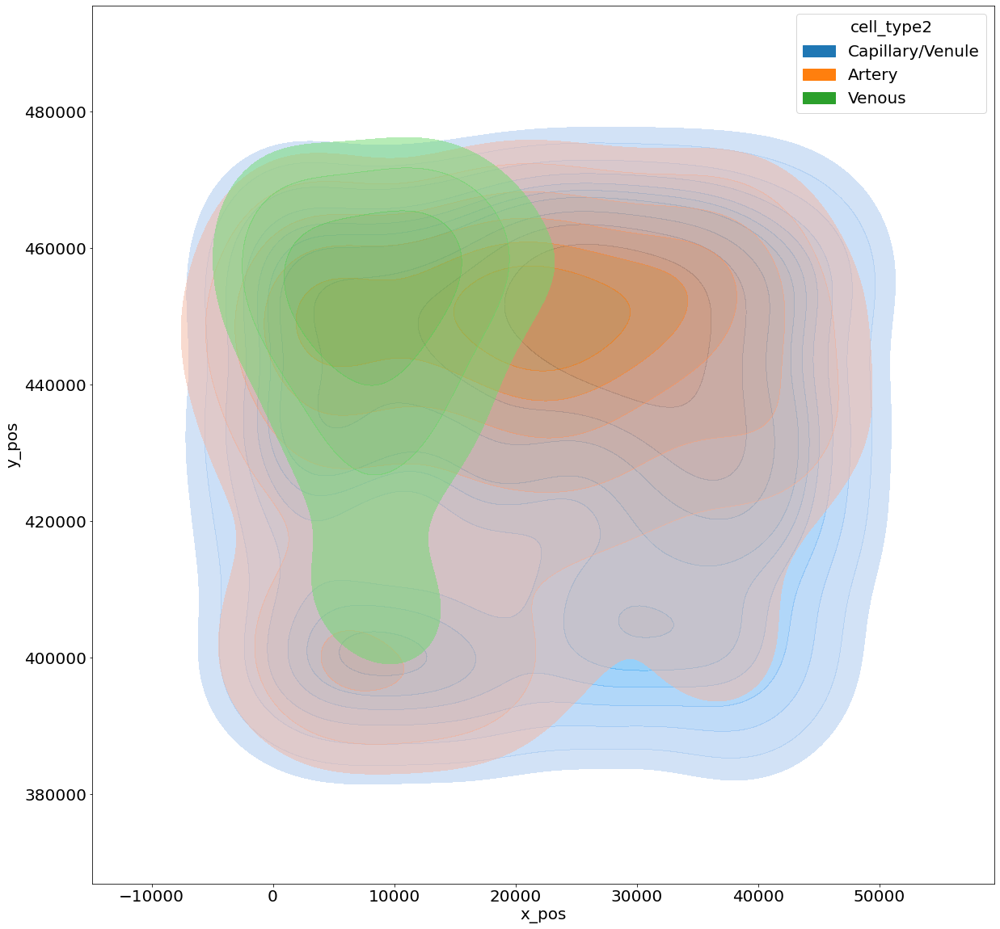

In [84]:
sns.kdeplot(x=subset.obs.x_pos, fill=True,alpha=.5, linewidth=0, 
            y=subset.obs.y_pos, data=df2, levels=[.05,.1,.2,.3,.4,.5,.6,.7,.8,.9,1],
            hue='cell_type2')

/home/chang/miniconda3/envs/venv/lib/python3.7/site-packages/seaborn/distributions.py:1185: UserWarning: The following kwargs were not used by contour: 'linewidth'
  **contour_kws,


<AxesSubplot:xlabel='x_pos', ylabel='y_pos'>

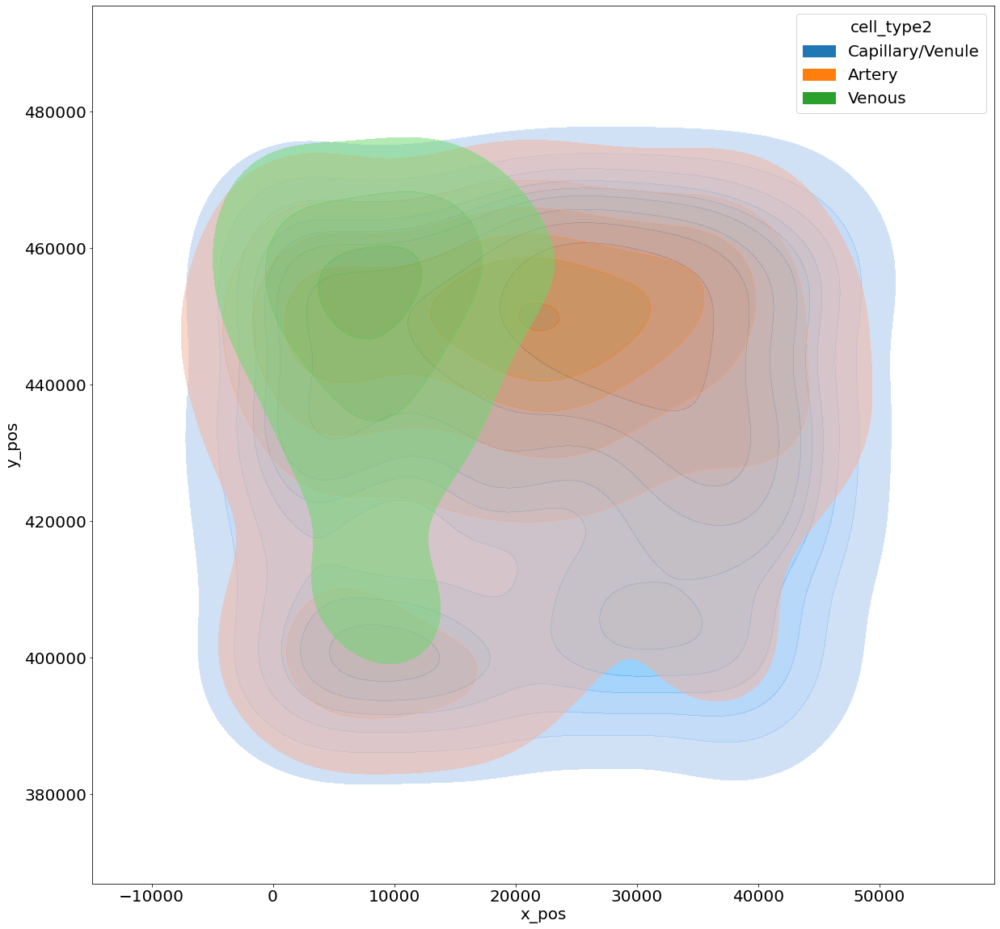

In [85]:
sns.kdeplot(x=subset.obs.x_pos, fill=True,alpha=.5, linewidth=0, 
            y=subset.obs.y_pos, data=df2,
            hue='cell_type2')

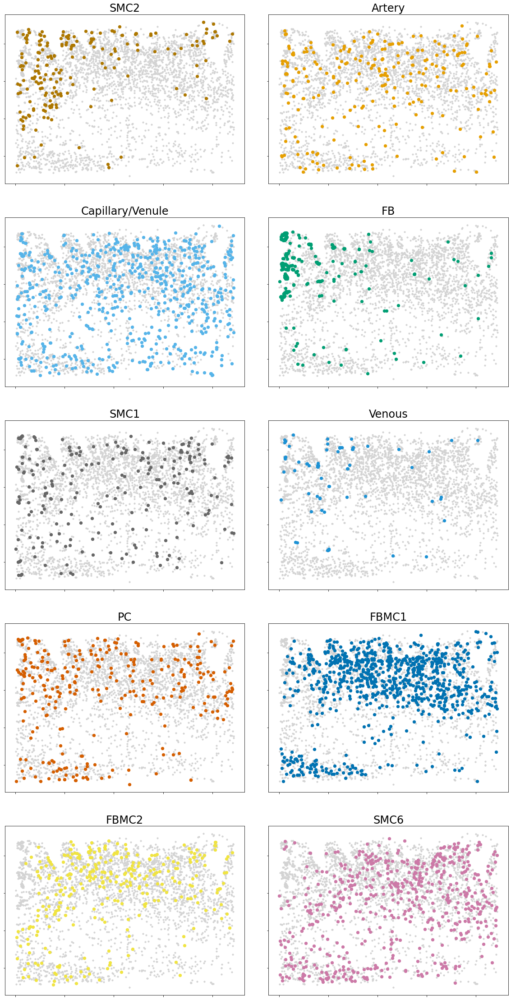

In [87]:
fig, axs = plt.subplots(5,2, figsize=(20, 40), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .2, wspace=.1)

for ax, i in zip(axs.ravel(), range(len(adata2.obs['cell_type2'].unique()))):
    ax.scatter(x=adata2.obs.x_pos,
            y=adata2.obs.y_pos,
            c='lightgrey',
            s=10,            
    )
    ax.scatter(x=adata2[adata2.obs['cell_type2'] == adata2.obs['cell_type2'].unique()[i]].obs.x_pos,
            y=adata2[adata2.obs['cell_type2'] == adata2.obs['cell_type2'].unique()[i]].obs.y_pos,
            c=adata2.obs['color'].unique()[i],
            s=40,
    )
    ax.axes.xaxis.set_ticklabels([])
    ax.axes.yaxis.set_ticklabels([])
    ax.set_title( adata2.obs['cell_type2'].unique()[i])
    ax.figure.savefig('split_plot.pdf')  

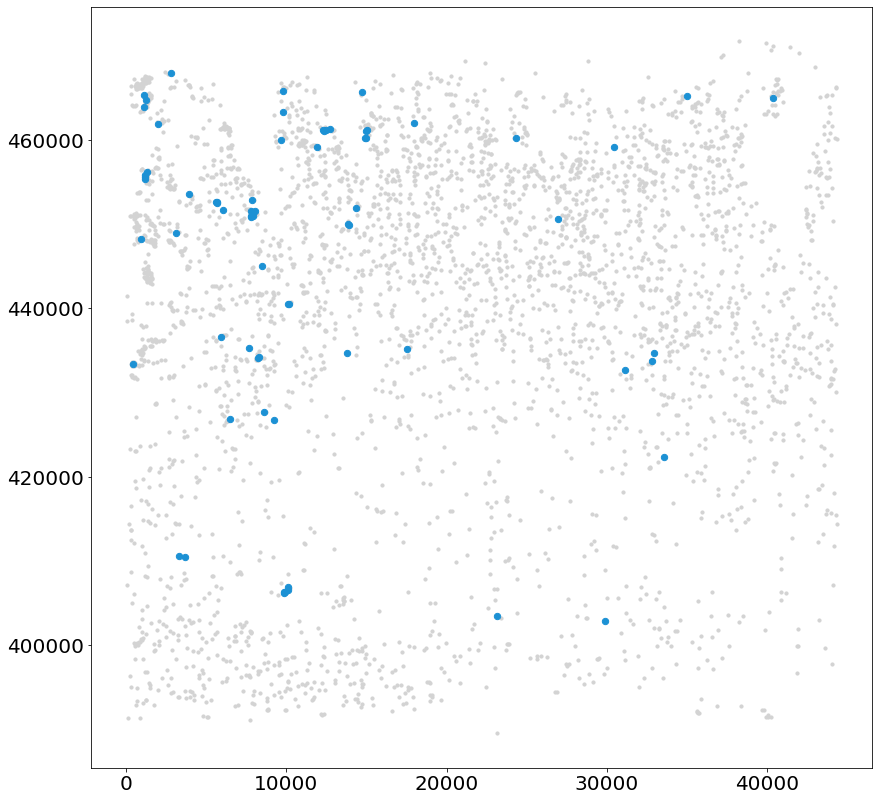

In [88]:
plt.figure(figsize=[14,14])

plt.rcParams['axes.facecolor'] = 'white'

plt.scatter(x=adata2.obs.x_pos,
            y=adata2.obs.y_pos,
            c='lightgrey',
            s=10,            
           )


plt.scatter(x=adata2[adata2.obs['cell_type2'] == 'Venous'].obs.x_pos,
            y=adata2[adata2.obs['cell_type2'] == 'Venous'].obs.y_pos,
             c='#1C91D4',
            s=40,
           )   

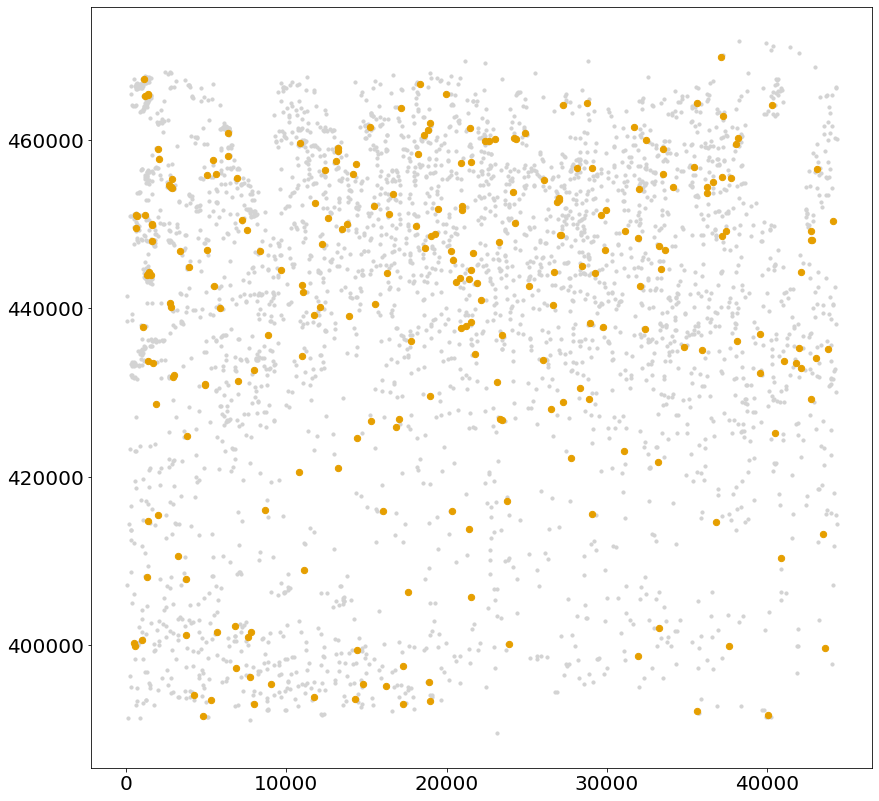

In [89]:
plt.figure(figsize=[14,14])

plt.rcParams['axes.facecolor'] = 'white'

plt.scatter(x=adata2.obs.x_pos,
            y=adata2.obs.y_pos,
            c='lightgrey',
            s=10,            
           )


plt.scatter(x=adata2[adata2.obs['cell_type2'] == 'Artery'].obs.x_pos,
            y=adata2[adata2.obs['cell_type2'] == 'Artery'].obs.y_pos,
             c='#E69F00',
            s=40,
           )   

<AxesSubplot:xlabel='x_pos', ylabel='y_pos'>

<Figure size 1008x1008 with 0 Axes>

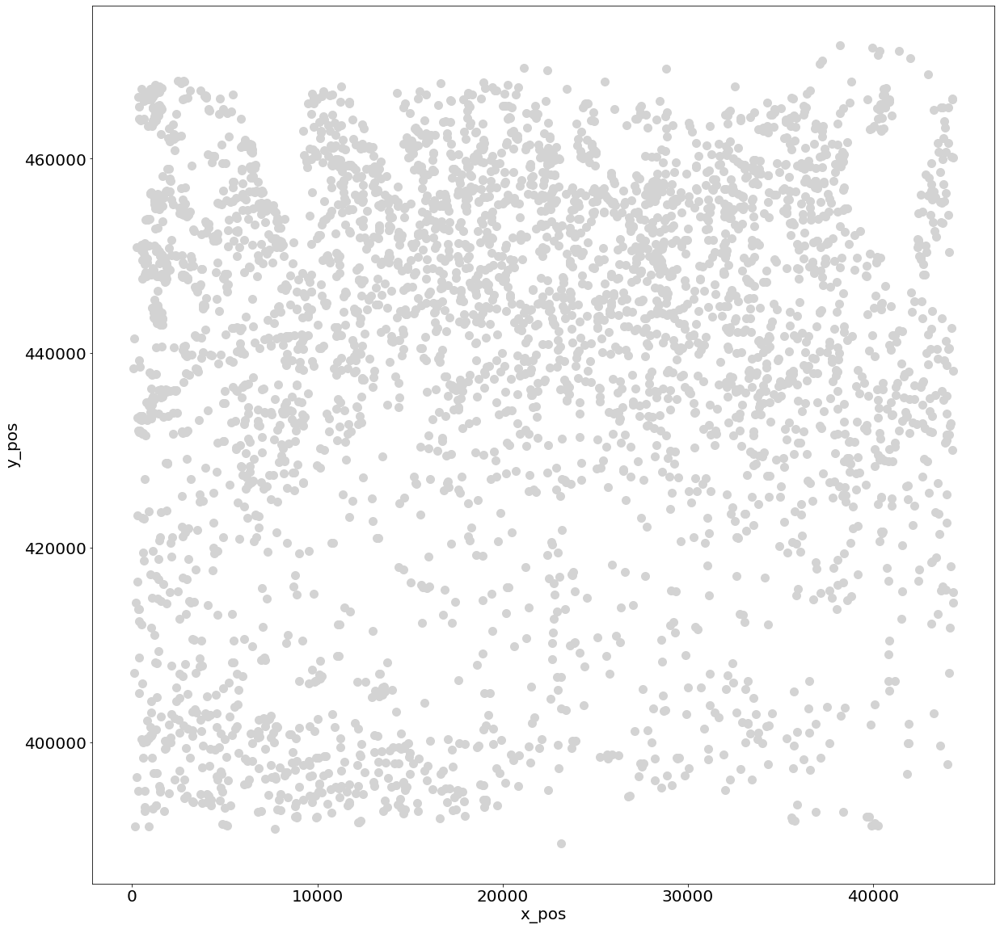

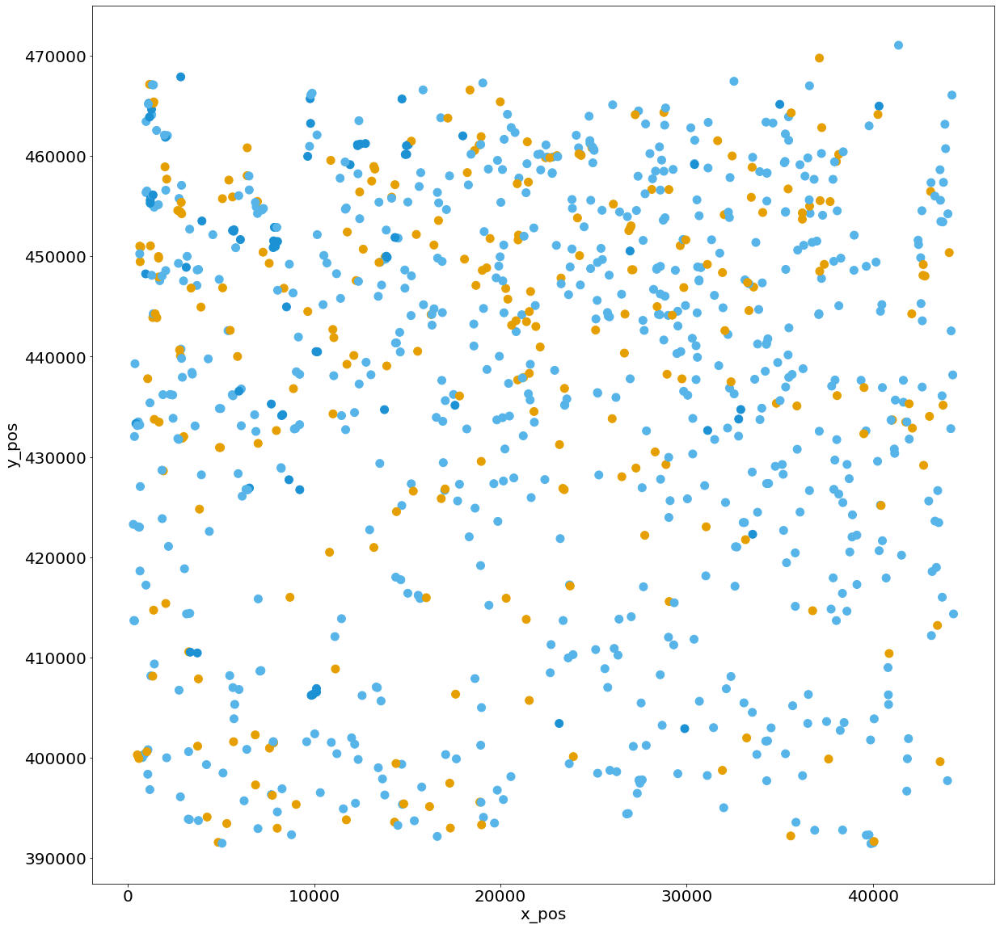

In [92]:
plt.figure(figsize=[14,14])

plt.rcParams['axes.facecolor'] = 'white'

colors = {'Artery':'#E69F00',
          'Venous':'#1C91D4',
          'Capillary/Venule':'#56B4E9'
         }
adata2.obs.plot.scatter(x='x_pos',
                      y='y_pos',
                      c='lightgrey',
                       s=100
                      )
adata_subset = adata2[adata2.obs['cell_type2'].isin(['Capillary/Venule', 'Artery',"Venous"])]
adata_subset.obs.plot.scatter(x='x_pos',
                      y='y_pos',
                      c=adata_subset.obs['cell_type2'].apply(lambda x: colors[x]),
                       s=100
                      )

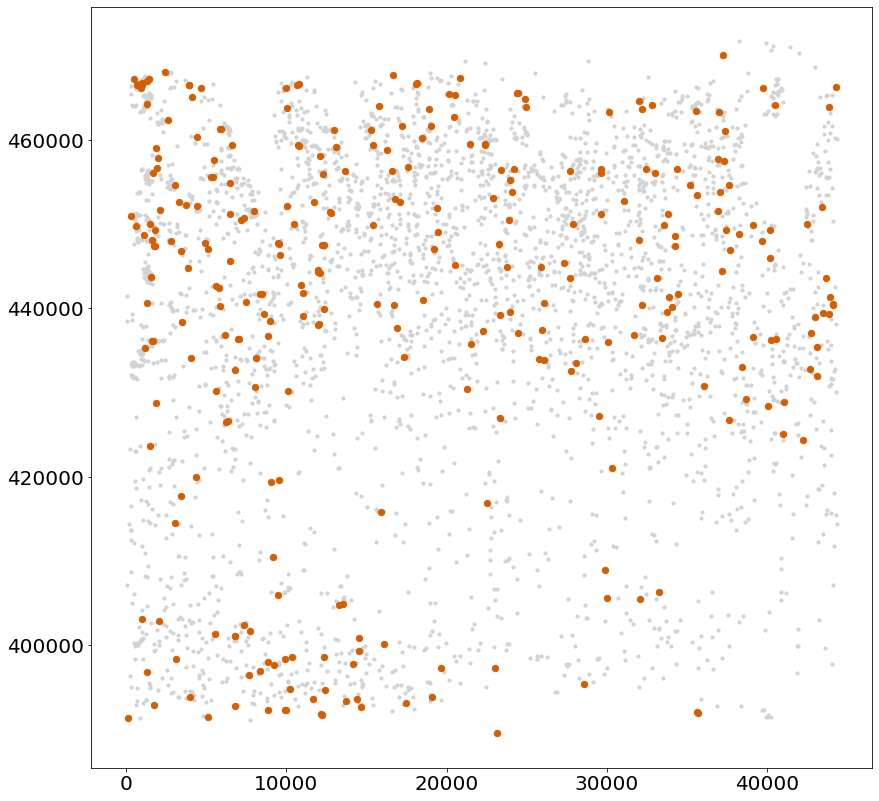

In [93]:
plt.figure(figsize=[14,14])

plt.rcParams['axes.facecolor'] = 'white'

plt.scatter(x=adata2.obs.x_pos,
            y=adata2.obs.y_pos,
            c='lightgrey',
            s=10,            
           )


plt.scatter(x=adata2[adata2.obs['cell_type'] == 'PC'].obs.x_pos,
            y=adata2[adata2.obs['cell_type'] == 'PC'].obs.y_pos,
             c='#D55E00',
            s=40,
           )   

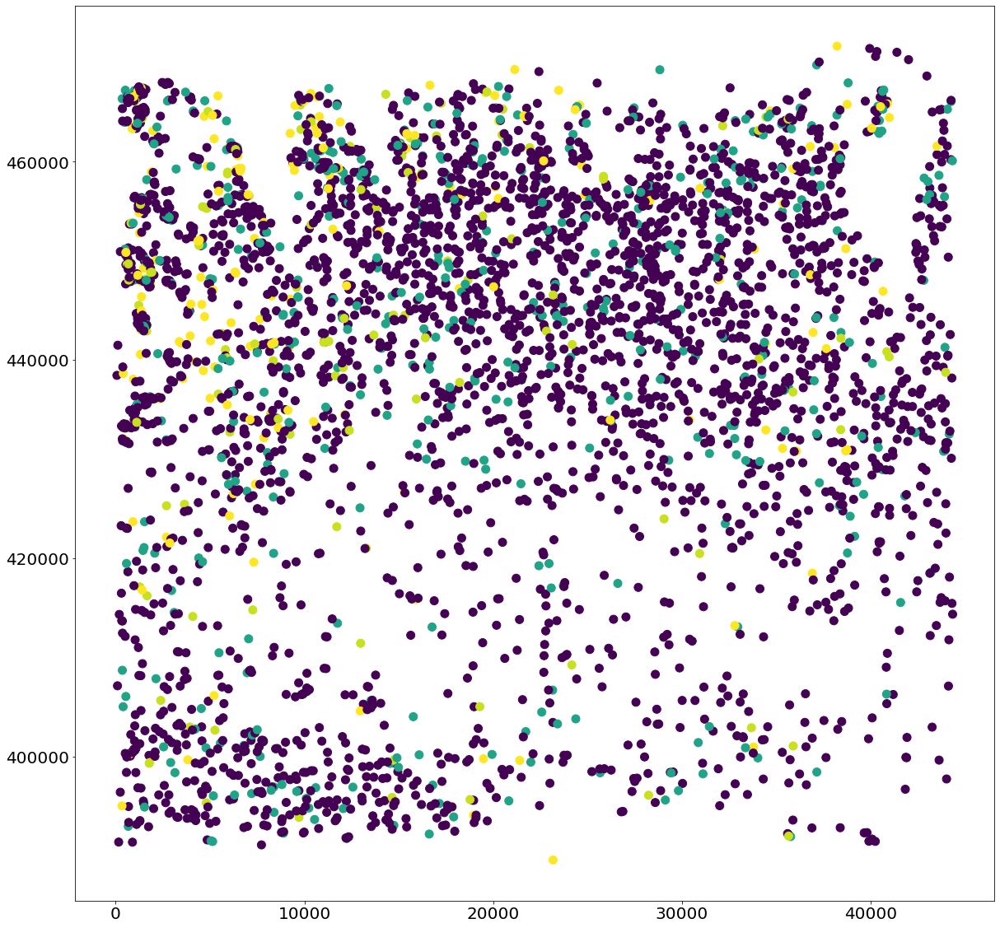

In [101]:
plt.scatter(x=adata2.obs.x_pos,
            y=adata2.obs.y_pos,
            c=adata2.to_df()['RGS16'],
            s=100,
            cmap='viridis',
            vmax=2            
           )

"\nplt.scatter(x=adata[adata.obs.cell_type == 'astrocyte'].obs.x_pos,\n            y=adata[adata.obs.cell_type == 'astrocyte'].obs.y_pos,\n             c=adata[adata.obs.cell_type == 'astrocyte'].obs.color,\n            s=20,\n           )"

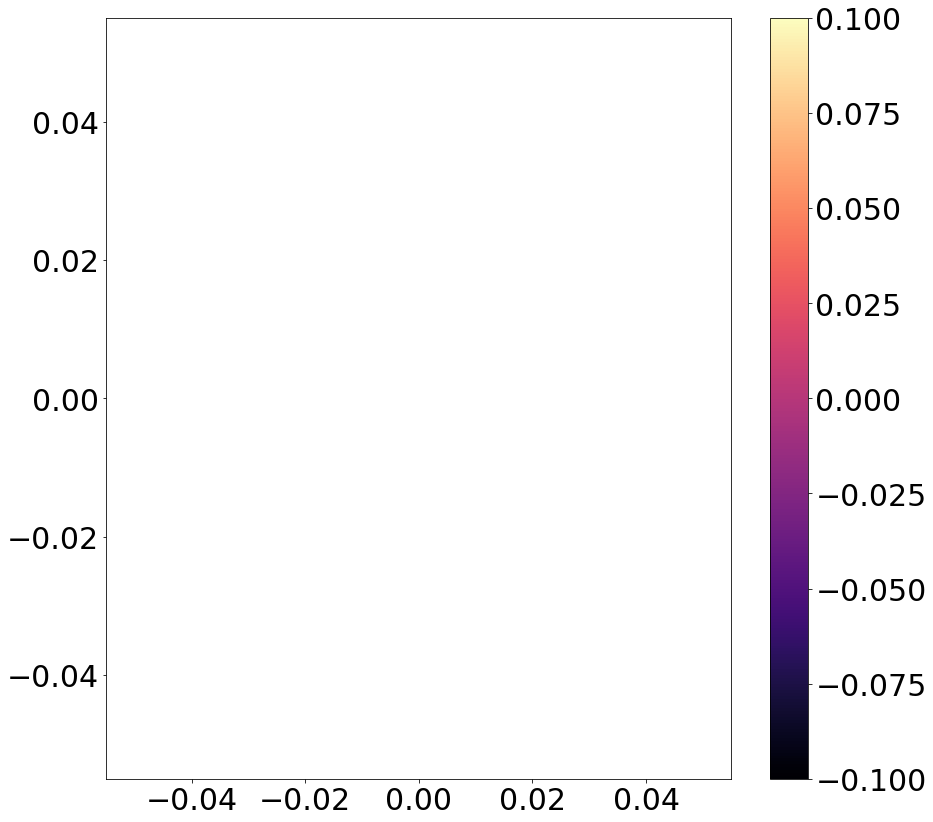

In [214]:
plt.figure(figsize=[14,14])




plt.scatter(x=adata2.obs.x_pos,
            y=adata2.obs.y_pos,
            s=10, c=adata2.obs['log_counts'],cmap='magma'
         #   edgecolors='white'
           )
plt.colorbar()
'''
plt.scatter(x=adata.obs.x_pos,
            y=adata.obs.y_pos,
            s=10, c=adata.obs['n_genes'],cmap='magma'
         #   edgecolors='white'
           )
plt.colorbar()
'''

'''
plt.scatter(x=adata[adata.obs.cell_type == 'astrocyte'].obs.x_pos,
            y=adata[adata.obs.cell_type == 'astrocyte'].obs.y_pos,
             c=adata[adata.obs.cell_type == 'astrocyte'].obs.color,
            s=20,
           )'''

In [39]:
from random import random

import bokeh.io
from bokeh.io import output_notebook, show

from bokeh.layouts import row
from bokeh.models import CustomJS, ColumnDataSource


from bokeh.plotting import figure
from bokeh.models.widgets import DataTable, DateFormatter, TableColumn

from bokeh.resources import INLINE
bokeh.io.output_notebook(INLINE)

from bokeh.models import Button

Loading BokehJS ...

In [452]:
x = adata.obs.x_pos.to_list()
y = adata.obs.y_pos.to_list()

s1 = ColumnDataSource(data=dict(x=x, y=y))
p1 = figure(plot_width=800, plot_height=800, tools="lasso_select", title="Select Here")
p1.circle('x', 'y', source=s1, alpha=0.6, size=1)

s2 = ColumnDataSource(data=dict(x=[], y=[]))
p2 = figure(plot_width=400, plot_height=400, x_range=(0, 1), y_range=(0, 1),
            tools="", 
     #       title="Watch Here",
           )




p2.circle('x', 'y', source=s2, alpha=0.6)

columns = [TableColumn(field ="x",  title = "X axis"),
           TableColumn(field ="y",  title = "Y axis")]

table = DataTable(source =s2, columns = columns, width =155, height = 380)




s1.selected.js_on_change('indices',
                         CustomJS(args=dict(s1=s1, s2=s2, table=table),
                        code="""
        var inds = cb_obj.indices;
        var d1 = s1.data;
        var d2 = s2.data;
        d2['x'] = []
        d2['y'] = []
        for (var i = 0; i < inds.length; i++) {
            d2['x'].push(d1['x'][inds[i]])
            d2['y'].push(d1['y'][inds[i]])
        }
        s2.change.emit();
        table.change.emit();
    """)
)

button = Button(label="Download",
                button_type="success"
               )

button.js_on_click(CustomJS(args=dict(source=s2),
                            
                            code=open("download.js").read()
                           
                           ))


layout = row(p1, table, button)



show(layout)

In [40]:
adata.obs['spatial']='SP'

In [41]:
section_vz_1=pd.read_csv('/Users/derekbogdanoff/Downloads/bokeh_vz_1-1-2.csv')
section_vz_2=pd.read_csv('/Users/derekbogdanoff/Downloads/bokeh_vz_2-1-2.csv')

section_cp=pd.read_csv('/Users/derekbogdanoff/Downloads/bokeh_cp-1.csv')

In [42]:
section_vz_1.columns = ['x_pos','y_pos']
section_vz_2.columns = ['x_pos','y_pos']

section_cp.columns = ['x_pos','y_pos']

In [43]:
section_vz_1 = adata.obs.reset_index().merge(section_vz_1, on=['x_pos','y_pos']).set_index('index')
section_vz_2 = adata.obs.reset_index().merge(section_vz_2, on=['x_pos','y_pos']).set_index('index')

section_cp = adata.obs.reset_index().merge(section_cp, on=['x_pos','y_pos']).set_index('index')

In [44]:
section_vz_1['spatial']='VZ_1'
section_vz_2['spatial']='VZ_2'

section_cp['spatial']='CP'

In [45]:
adata.obs.update(section_vz_2)

In [46]:
adata.obs.update(section_vz_1)

In [47]:
adata.obs.update(section_cp)

In [48]:
adata.obs.spatial.unique()

array(['CP', 'SP', 'VZ_2', 'VZ_1'], dtype=object)

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt

In [50]:
from pylab import *

cmap = cm.get_cmap('tab10', 10)

for i in range(cmap.N):
    rgb = cmap(i)[:3] # will return rgba, we take only first 3 so we get rgb
    print(matplotlib.colors.rgb2hex(rgb))

#1f77b4
#ff7f0e
#2ca02c
#d62728
#9467bd
#8c564b
#e377c2
#7f7f7f
#bcbd22
#17becf


In [51]:
colors = {'CP':'#1f77b4',
          'SP':'#9467bd',
          'VZ_1':'#2ca02c',
          'VZ_2':'#ff7f0e'
         }

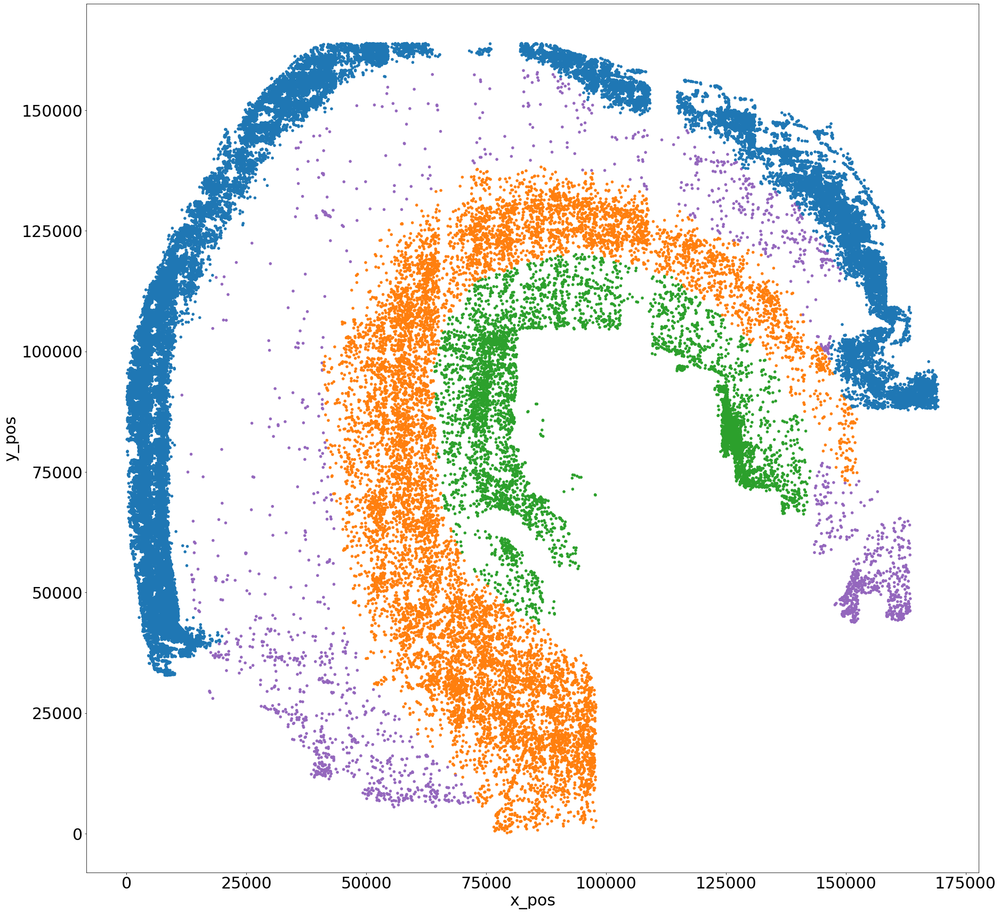

In [52]:
plt.rcParams['figure.figsize'] = 30,30
plt.rcParams['axes.facecolor'] = 'white'

plt.rcParams['legend.fontsize'] = 10
plt.rcParams['axes.titlesize'] = 10


plt.rcParams['legend.fontsize'] = 10

plt.rcParams['lines.markersize']= 10

plt.rcParams['axes.facecolor'] = 'white'




adata.obs.plot.scatter(x='x_pos',
                      y='y_pos',
                      c=adata.obs['spatial'].apply(lambda x: colors[x]),
                       s=20

                      )

           
# plt.scatter(x=adata_m.obs.x_pos,
#             y=adata_m.obs.y_pos,
#              c='black',
#             s=200,
                    
                    
#          #   edgecolors='white'
            
#            )

In [537]:
adata.obs.cell_type.unique()

array(['1', 'astrocyte', '0', 'microglia'], dtype=object)

In [57]:
adata_m = adata[adata.obs.cell_type == 'microglia']

In [61]:
adata_m.obs.index

TypeError: 'Index' object is not callable

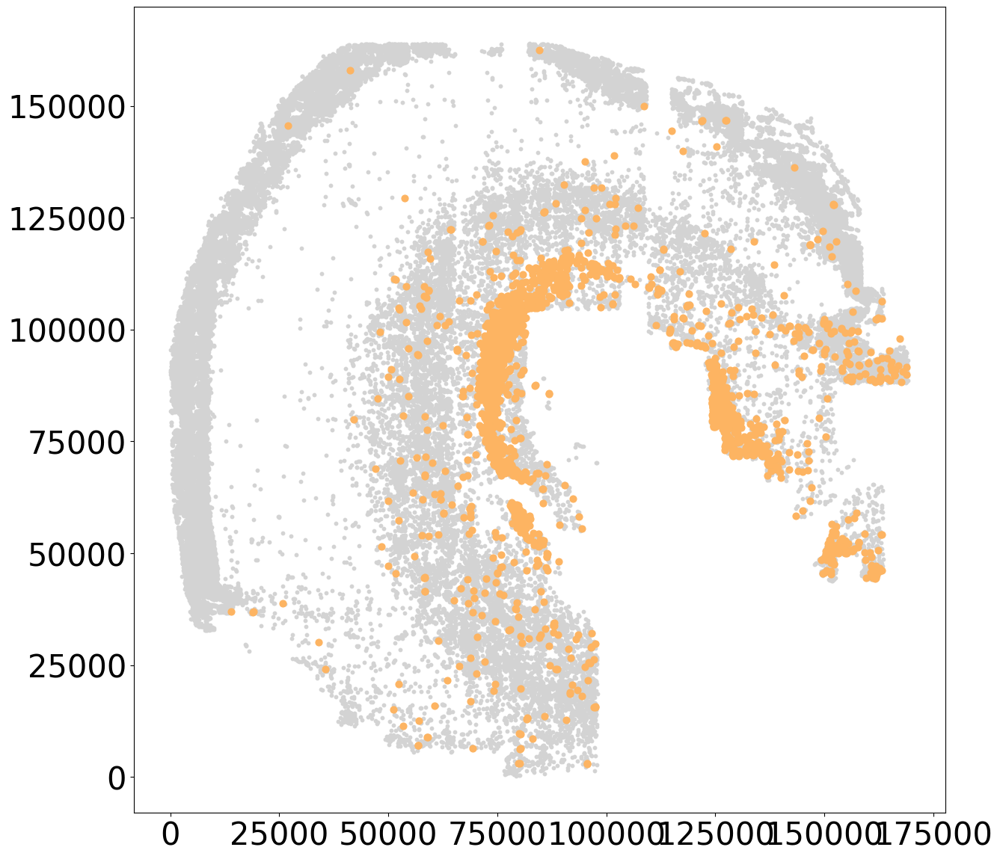

In [584]:
plt.figure(figsize=[14,14])

plt.rcParams['axes.facecolor'] = 'white'

plt.scatter(x=adata.obs.x_pos,
            y=adata.obs.y_pos,
            c='lightgrey',
            s=10,
      
         #   edgecolors='white'
            
            
            
           )



plt.scatter(x=adata[adata.obs['cell_type'] == 'microglia'].obs.x_pos,
            y=adata[adata.obs['cell_type'] == 'microglia'].obs.y_pos,
             c='#fdb462',
            s=40,
                    
                    
         #   edgecolors='white'
            
           )       
            
            
            
           
# plt.scatter(x=adata_m.obs.x_pos,
#             y=adata_m.obs.y_pos,
#              c='red',
#             s=40,
                    
                    
#          #   edgecolors='white'
            
#            )

Text(0.5, 1.0, 'CD14')

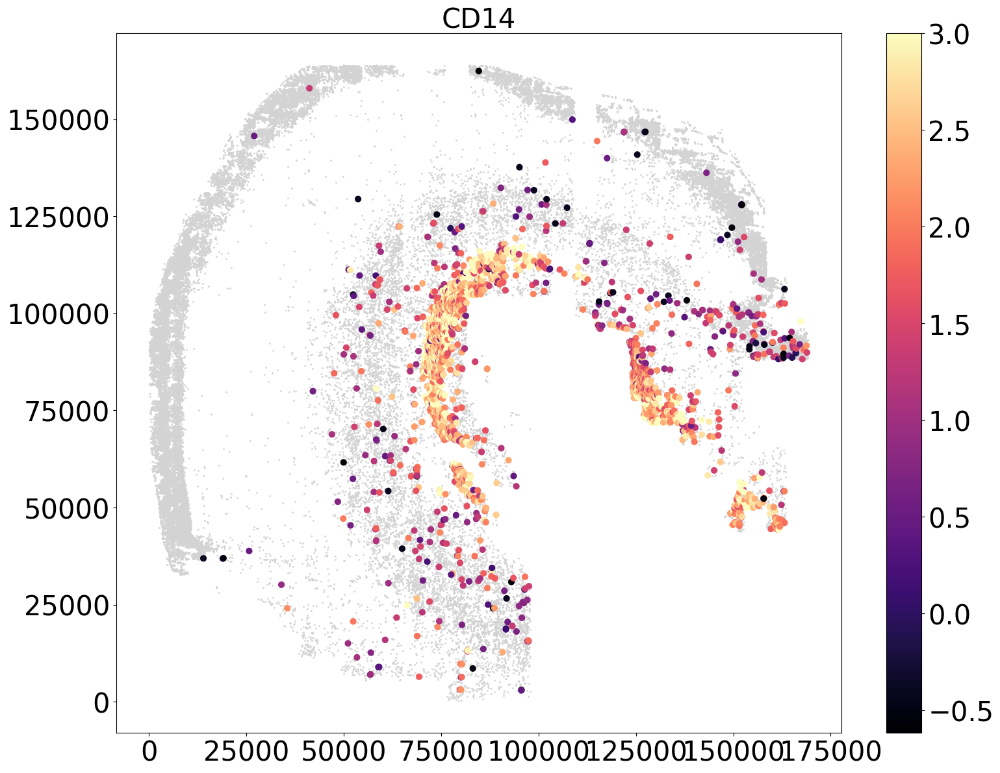

In [678]:
plt.figure(figsize=[18,14])

gene_list = ['TNF', 'CD14', 'SPP1', 'GPNMB', 'P2RY12']


plt.scatter(x=adata.obs.x_pos,
            y=adata.obs.y_pos,
            c='lightgrey',

            s=1,
                    
                    
         #   edgecolors='white'
            
           )
plt.scatter(x=adata_m.obs.x_pos,
            y=adata_m.obs.y_pos,
            c=adata_m.to_df()['CD14'],
            s=40,
            cmap='magma',
            vmax=3
    #        edgecolors= "white"
            
           )

plt.colorbar()
plt.title('CD14', fontsize=30)

In [661]:
df = adata.to_df()
df['cell_type'] = adata.obs.cell_type

/Users/derekbogdanoff/projects/venv3/lib/python3.8/site-packages/seaborn/matrix.py:1201: UserWarning: ``square=True`` ignored in clustermap
  warnings.warn(msg)


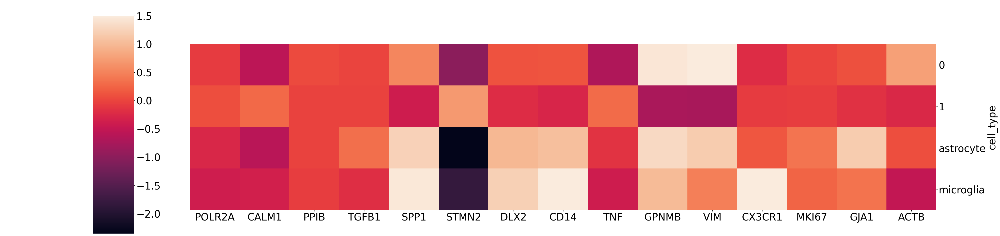

In [662]:
plt.rcParams['font.size'] = 30

sns.clustermap(
                
                df.groupby('cell_type').mean(),
                    
               col_cluster=False,
                row_cluster=False,
               
               **{'square':True},
     #          row_colors=row_colors,
             #   metric='cityblock' 
               figsize=(42,10),
               cbar_pos=(0.1,0,0.04,0.9),
                vmax=1.5,
                
    
    
    
     #          row_colors=row_colors    #df____.index.to_series().map(colors_m)
   
                
                    
              ).savefig("/Users/derekbogdanoff/Desktop/all_cells.pdf")


#cg.ax_row_dendrogram.set_visible(False)

In [585]:
df_ = adata_m.to_df()

In [586]:
df_['spatial']=adata_m.obs.spatial

In [587]:
df__ = df_.groupby('spatial').mean()

/Users/derekbogdanoff/projects/venv3/lib/python3.8/site-packages/seaborn/matrix.py:1201: UserWarning: ``square=True`` ignored in clustermap
  warnings.warn(msg)


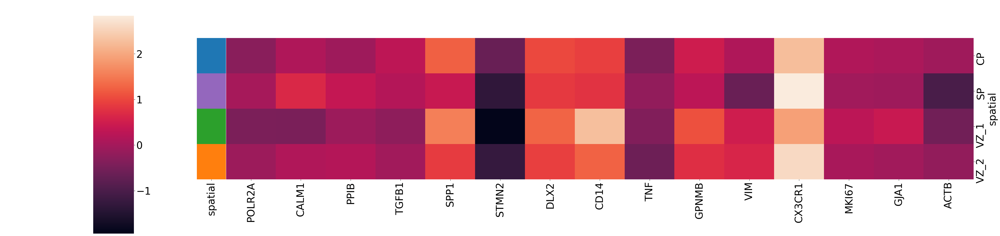

In [667]:
plt.rcParams['font.size'] = 30

sns.clustermap(df_.groupby('spatial').mean(),
                    
               col_cluster=False,
                row_cluster=False,
               
               **{'square':True},
     #          row_colors=row_colors,
             #   metric='cityblock' 
               figsize=(42,10),
               cbar_pos=(0.1,0,0.04,0.9),
               row_colors=df__.index.to_series().map(colors)
   
                
                    
              ).savefig("/Users/derekbogdanoff/Desktop/microglia_spatial.pdf")


#cg.ax_row_dendrogram.set_visible(False)

In [ ]:
sc.pl.violin(adata_m,
#             groupby='spatial',
            keys=[i],
            stripplot=False,
#             **{"palette":['#fbb4ae',"#b3cde3",'#decbe4','#f4cae4']},
#             **{"order":['CP','SP','VZ_2','VZ_1']} 
            )

In [ ]:
colors = {'CP':'#1f77b4',
          'SP':'#9467bd',\
          'VZ_1':'#2ca02c',
          'VZ_2':'#ff7f0e'
         }

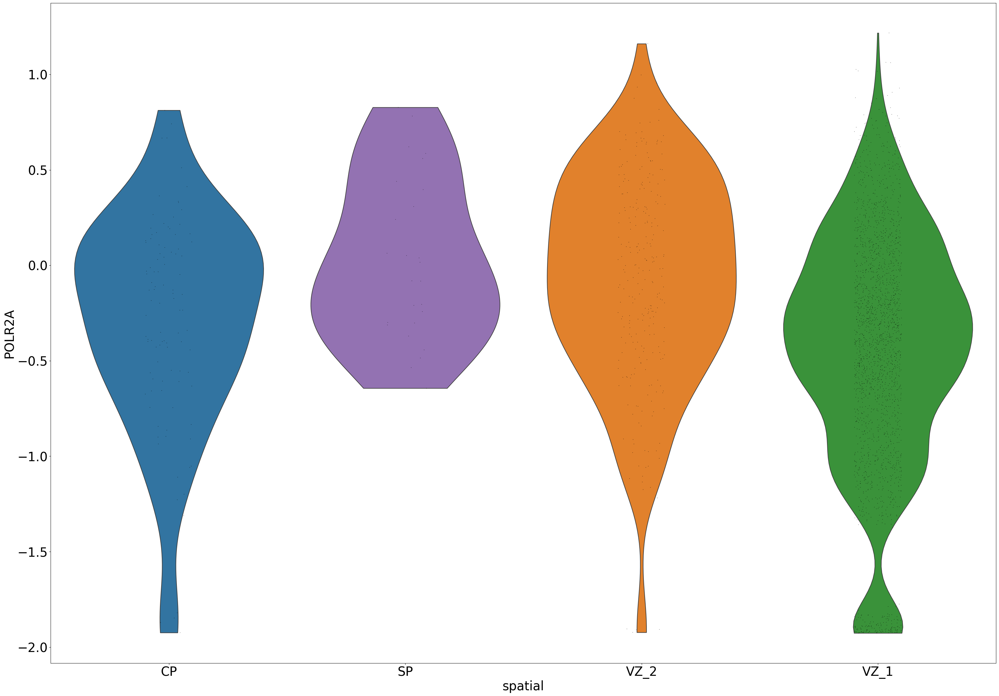

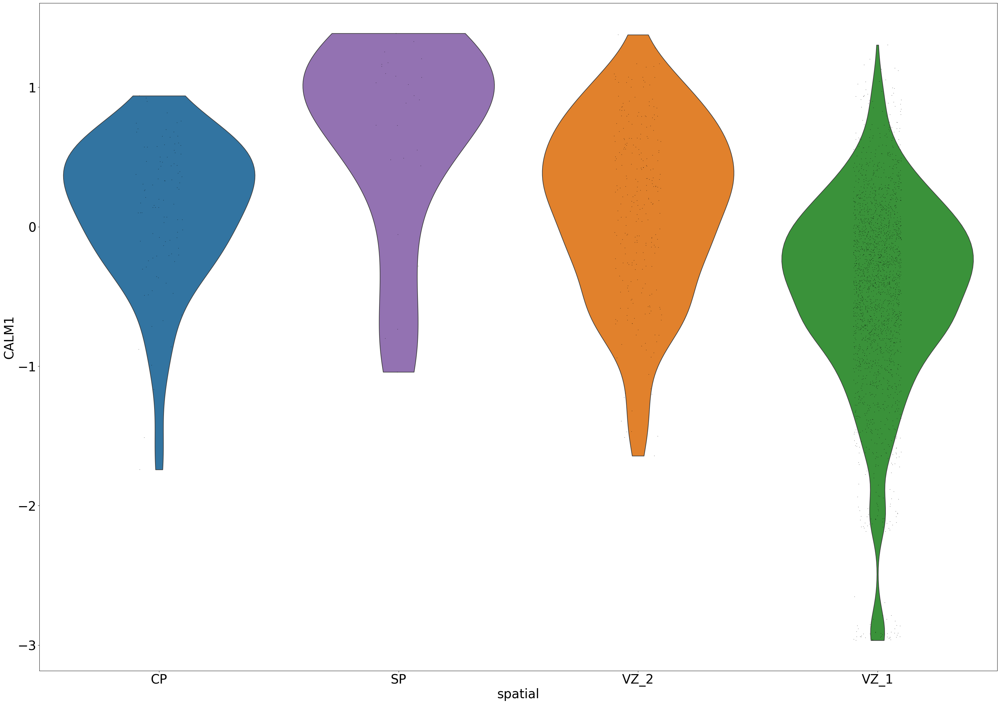

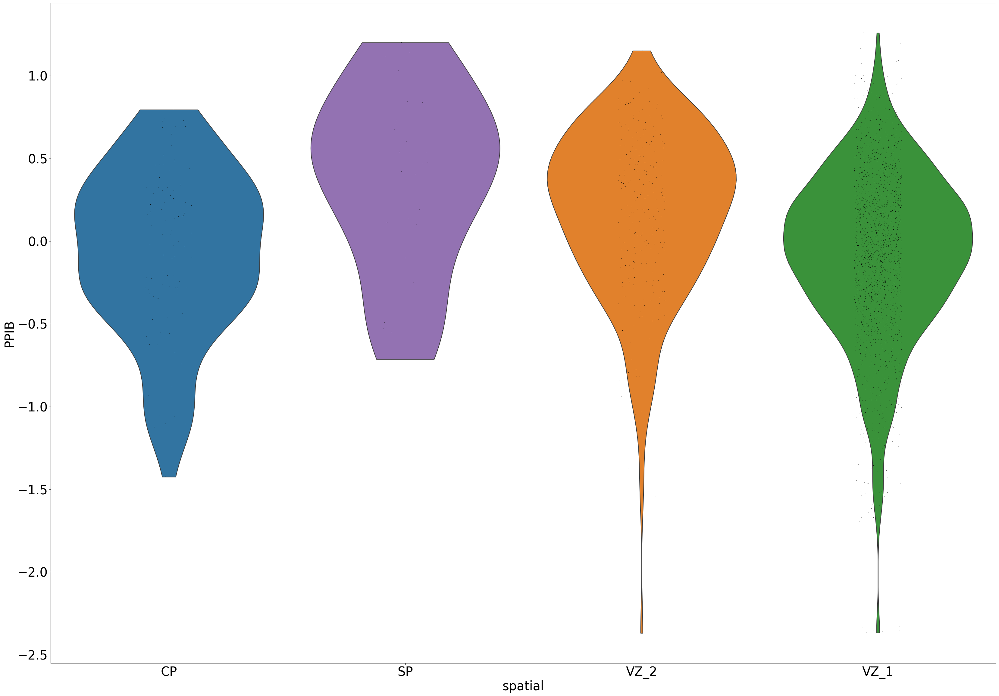

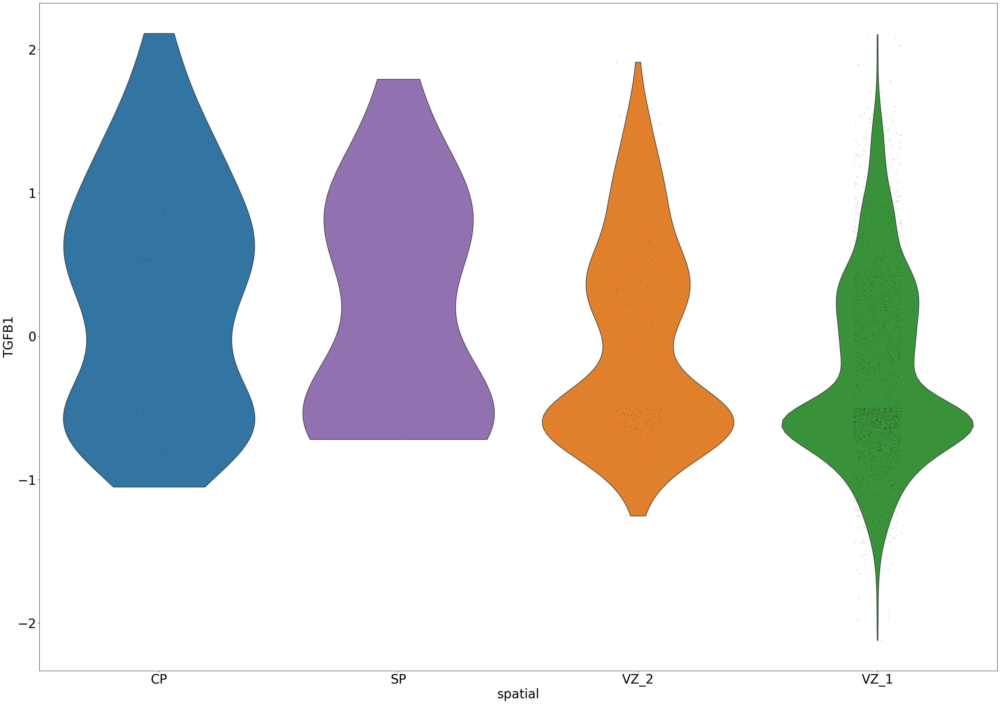

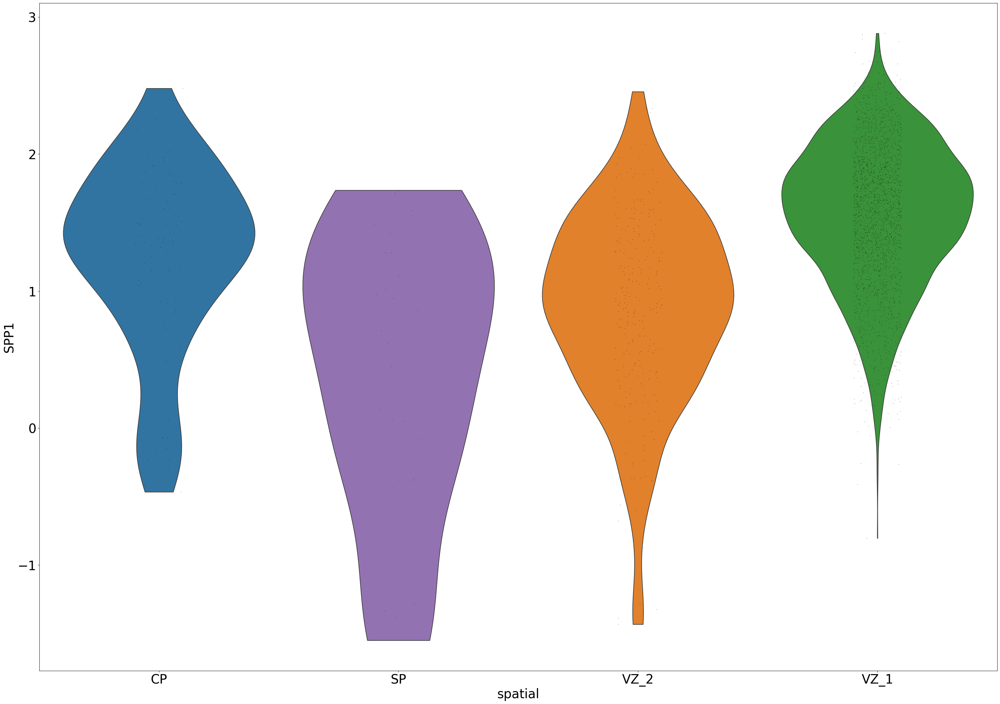

...

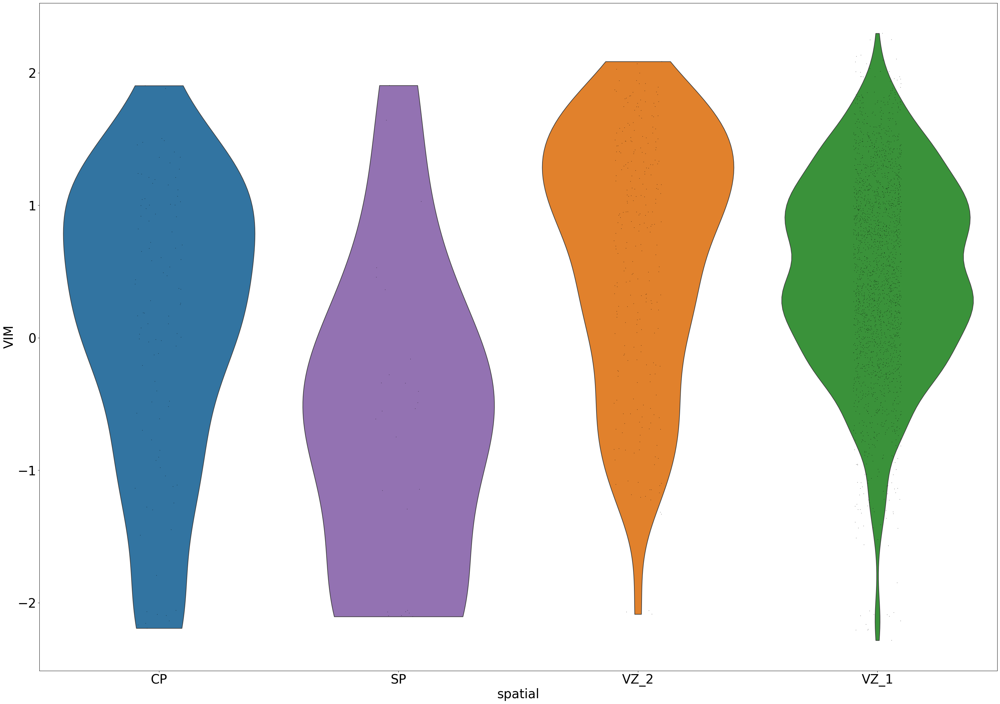

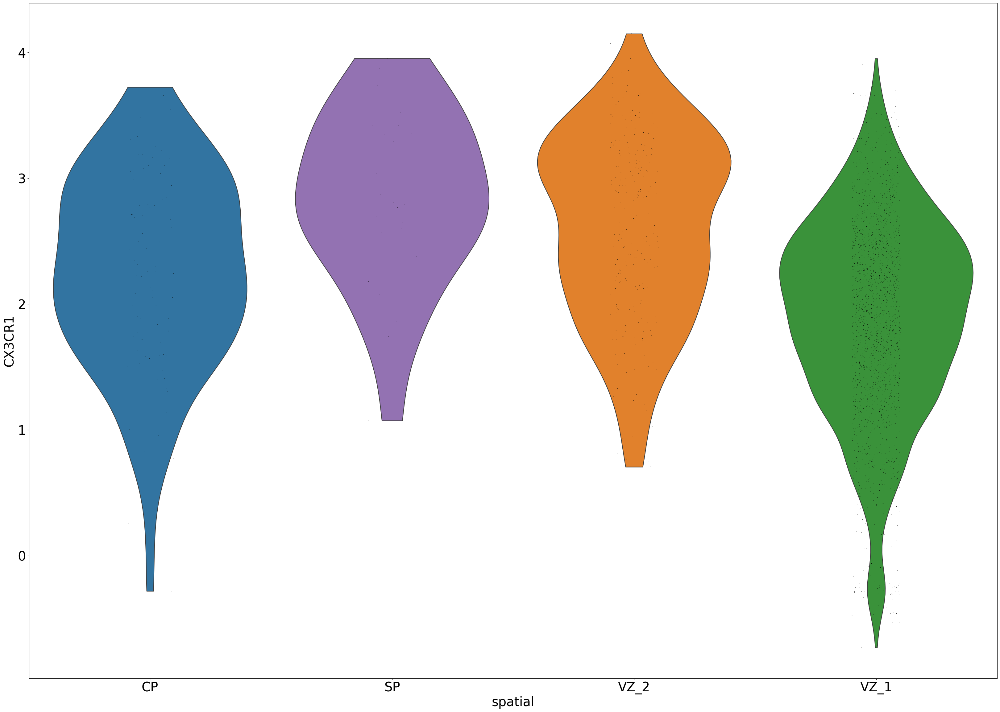

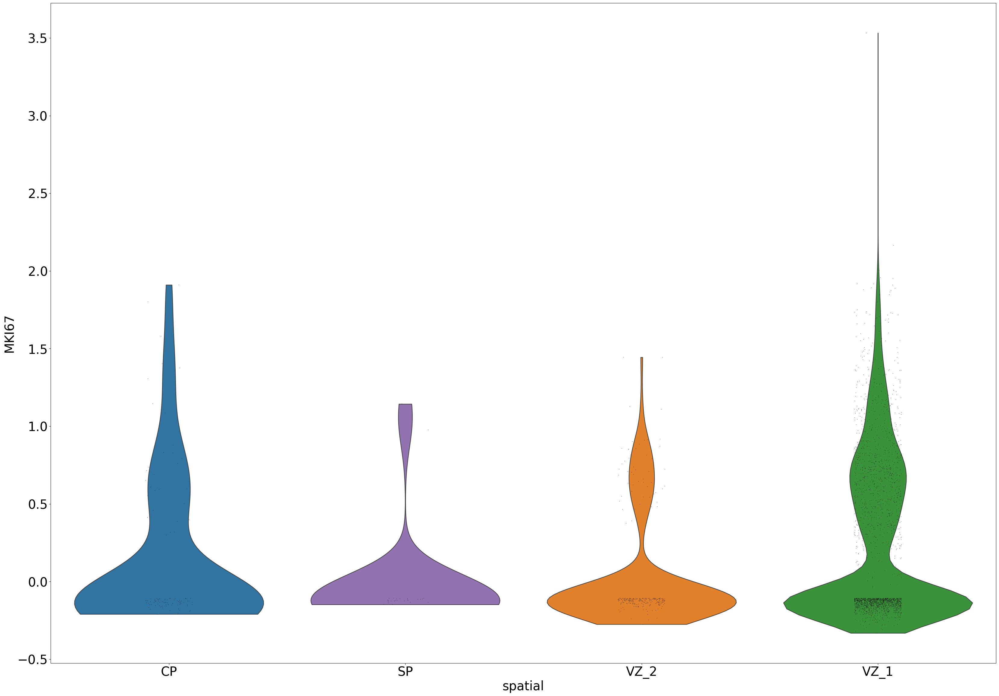

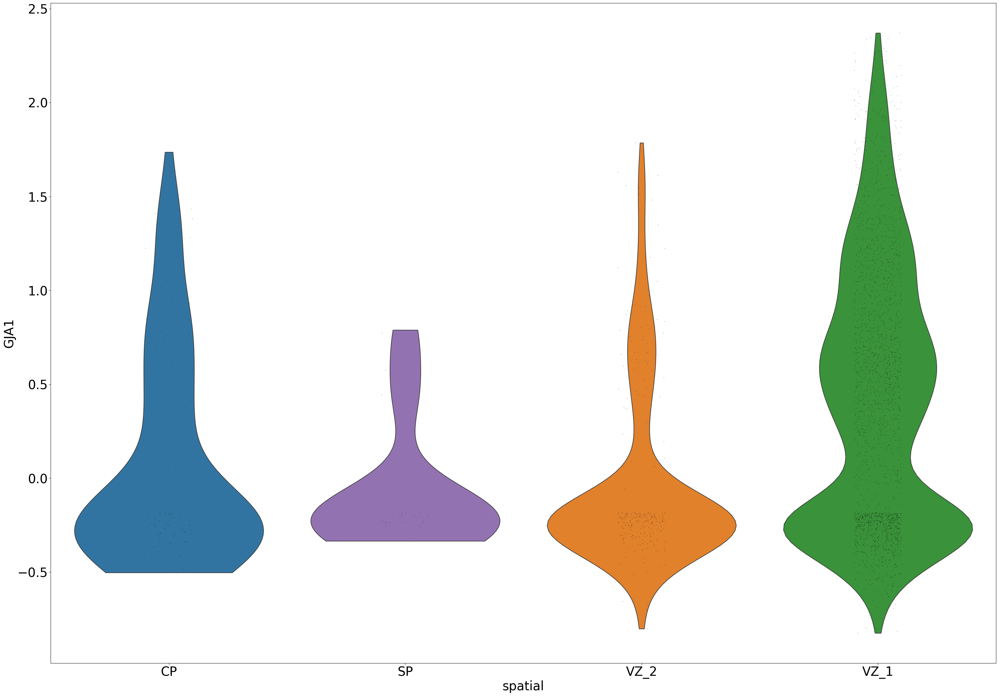

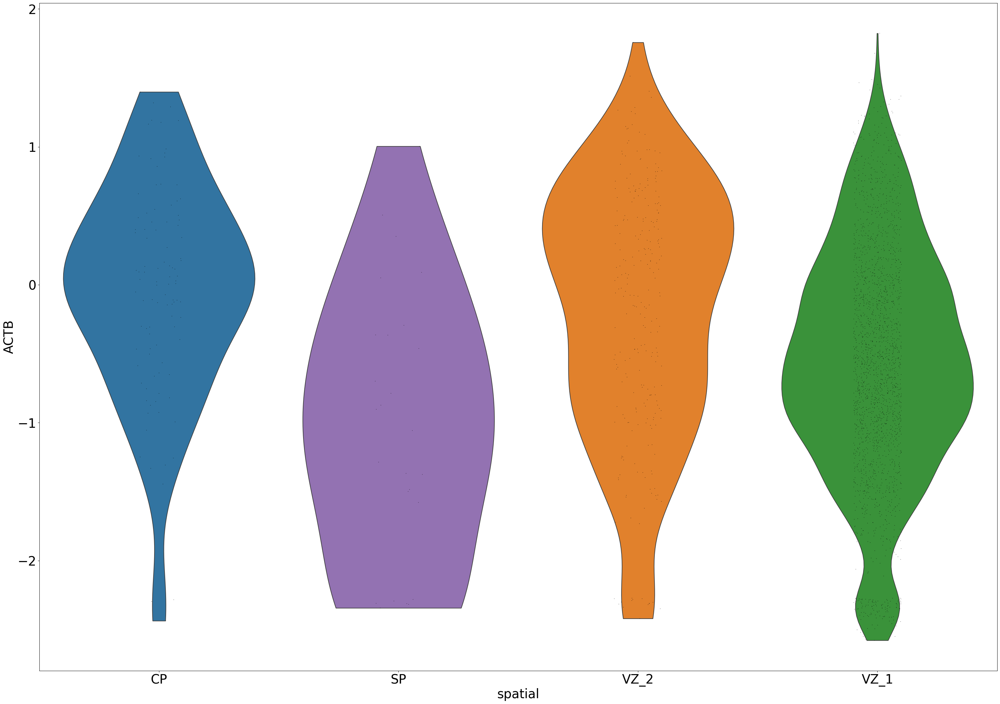

In [597]:
# fig, axs = plt.subplots(3,6, figsize=(15, 6), facecolor='w', edgecolor='k')

# fig.subplots_adjust(hspace = .5, wspace=.05)

# axs = axs.ravel()

#for i in range(len(adata_m.var_names)):

for i in adata.var_names.to_list():
    
    sc.pl.violin(adata_m,
            groupby='spatial',
            keys=[i],
            stripplot=True,
            **{"palette":['#1f77b4',"#9467bd",'#ff7f0e','#2ca02c']},
            **{"order":['CP','SP','VZ_2','VZ_1']} 
            )
    
    
    
    

In [ ]:
sc.pl.violin(adata_m,
            groupby='spatial',
            keys=[i],
            stripplot=False,
            **{"palette":['#fbb4ae',"#b3cde3",'#decbe4']},
            **{"order":['CP','SP','GZ']} 
            )

In [ ]:
for i in range(len(adata_m.var_names)):
    plt.subplot(2, 3, i)

In [553]:
from pylab import *

cmap = cm.get_cmap('Pastel2', 8)

for i in range(cmap.N):
    rgb = cmap(i)[:3] # will return rgba, we take only first 3 so we get rgb
    print(matplotlib.colors.rgb2hex(rgb))

#b3e2cd
#fdcdac
#cbd5e8
#f4cae4
#e6f5c9
#fff2ae
#f1e2cc
#cccccc


In [ ]:
#['TGFB1', 'P2RY12', 'SPP1', 'CD14', 'TNF', 'GPNMB', 'CX3CR1', 'CSF1R']

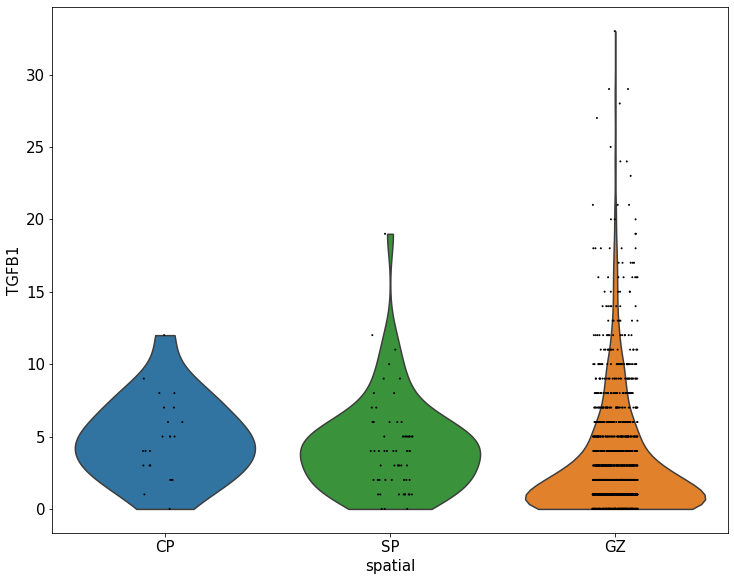

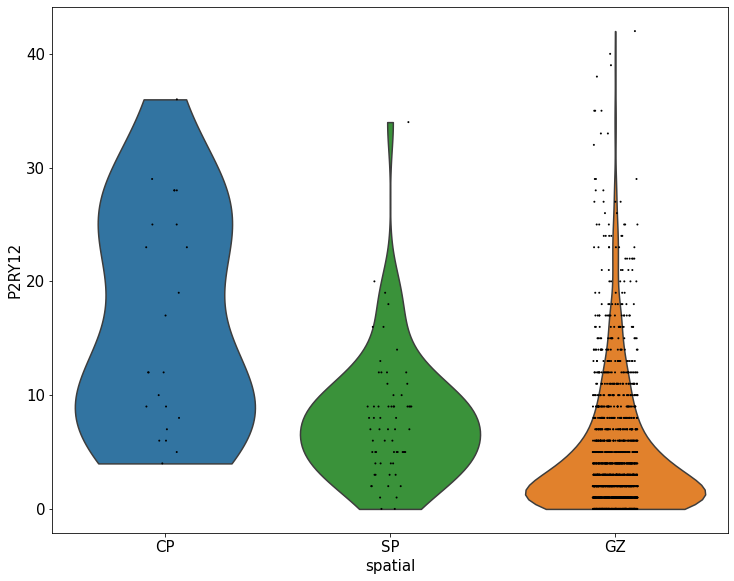

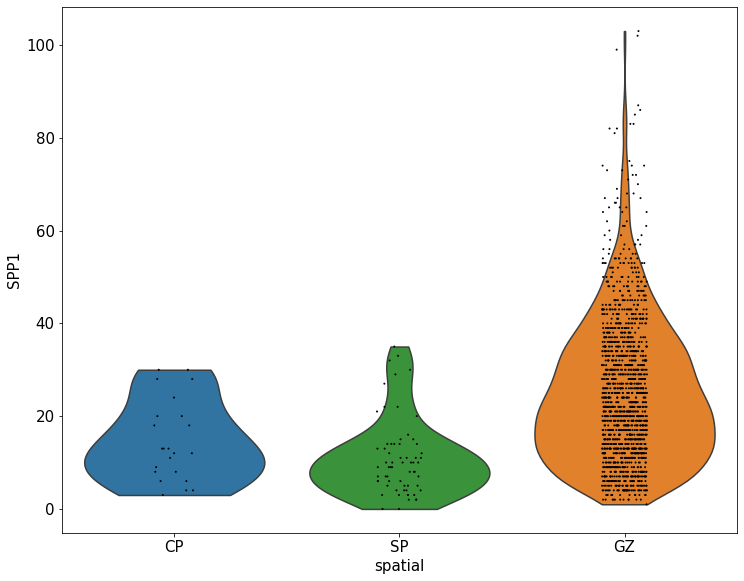

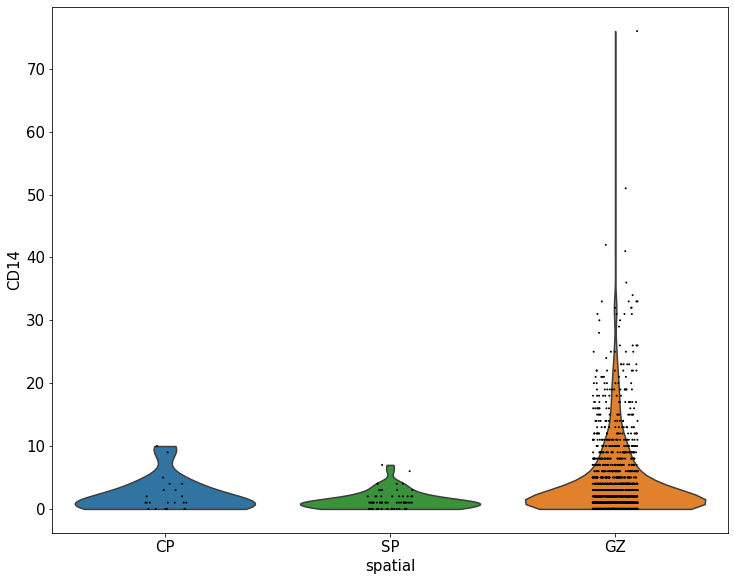

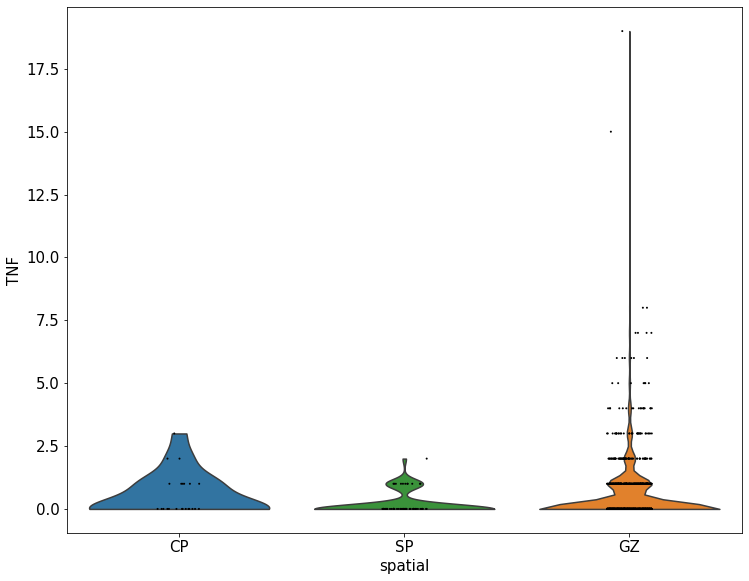

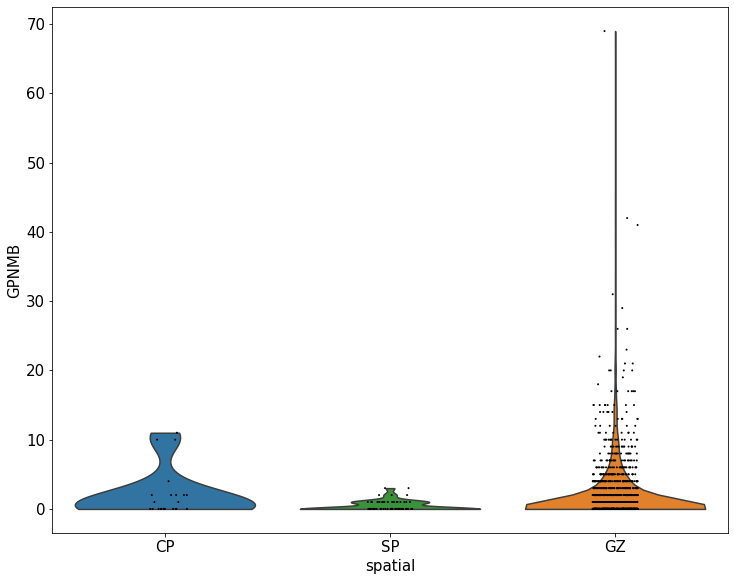

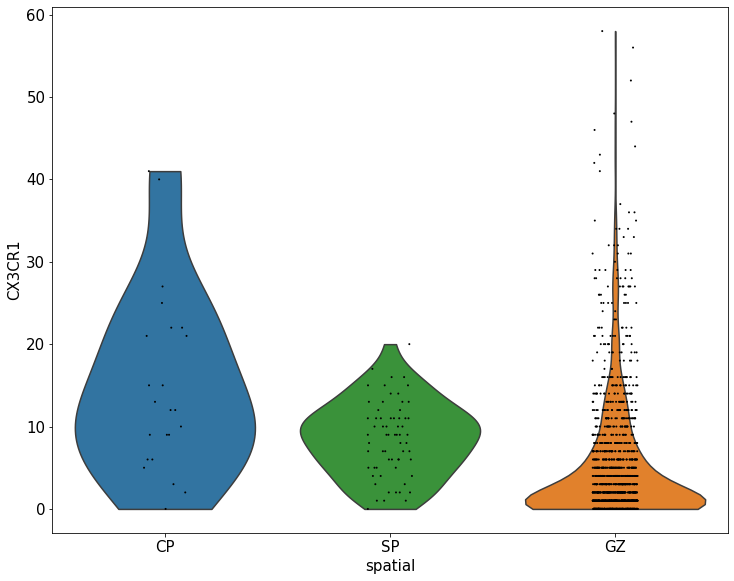

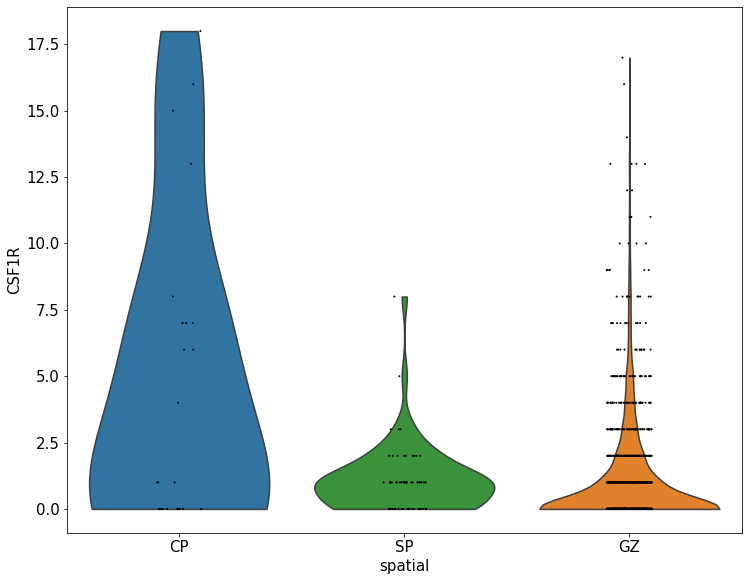

In [129]:
plt.rcParams['figure.figsize'] = 10,10
plt.rcParams['font.size'] = 15

for i in ['TGFB1', 'P2RY12', 'SPP1', 'CD14', 'TNF', 'GPNMB', 'CX3CR1', 'CSF1R']:
    sc.pl.violin(adata_m,
            groupby='spatial',
            keys=[i],
            stripplot=True,
            jitter=True,
            size=2,
                 
     #       **{"palette":['#fbb4ae',"#b3cde3",'#decbe4']},
            **{"order":['CP','SP','GZ']},
                 use_raw=True,
                 
                 
            )
    


In [598]:
adata_m

AnnData object with n_obs × n_vars = 2631 × 15
    obs: 'Cell No.', 'x_pos', 'y_pos', 'perimeter', 'n_counts', 'n_genes', 'log_counts', 'leiden', 'cell_type', 'color', 'spatial'
    uns: 'log1p', 'pca', 'neighbors', 'leiden', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_tsne'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [182]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)

In [605]:
sc.pp.neighbors(adata_m, n_neighbors=4, n_pcs=15)

sc.tl.leiden(adata_m,
            resolution=0.2)



sc.tl.umap(adata_m,
#                min_dist=.01,
#               spread=1,
#               alpha=1,
          )

AnnData object with n_obs × n_vars = 2631 × 15
    obs: 'Cell No.', 'x_pos', 'y_pos', 'perimeter', 'n_counts', 'n_genes', 'log_counts', 'leiden', 'cell_type', 'color', 'spatial'
    uns: 'log1p', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_colors'
    obsm: 'X_pca', 'X_umap', 'X_tsne'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

... storing 'color' as categorical


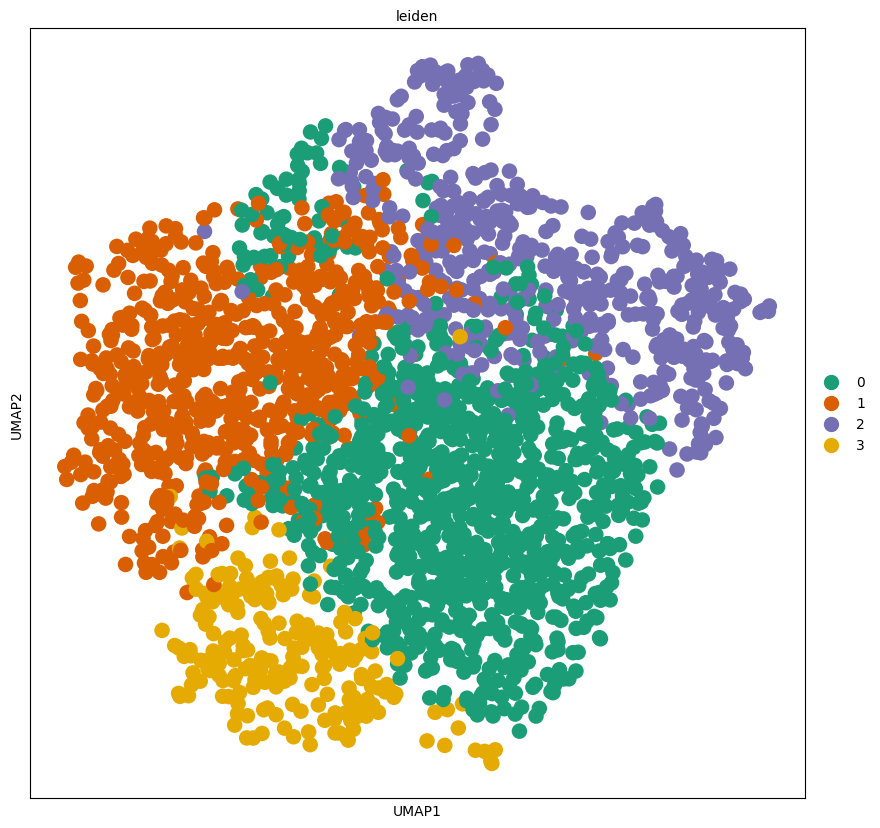

In [630]:
plt.rcParams['figure.figsize'] = 10, 10


sc.pl.umap(
    adata_m,
          color=[
              'leiden',
                ],
    palette=
    
    
    
    [
'#1b9e77',
'#d95f02',
'#7570b3',
'#e6ab02',
#'#66a61e',
#'#e7298a',
# '#a6761d',
# '#666666',
     ] 
    
    
    
    
    
    ,
    size=500,
    ncols=1,
    use_raw=False,
    #sc.pl.palettes.vega
 #   add_outline=True
)

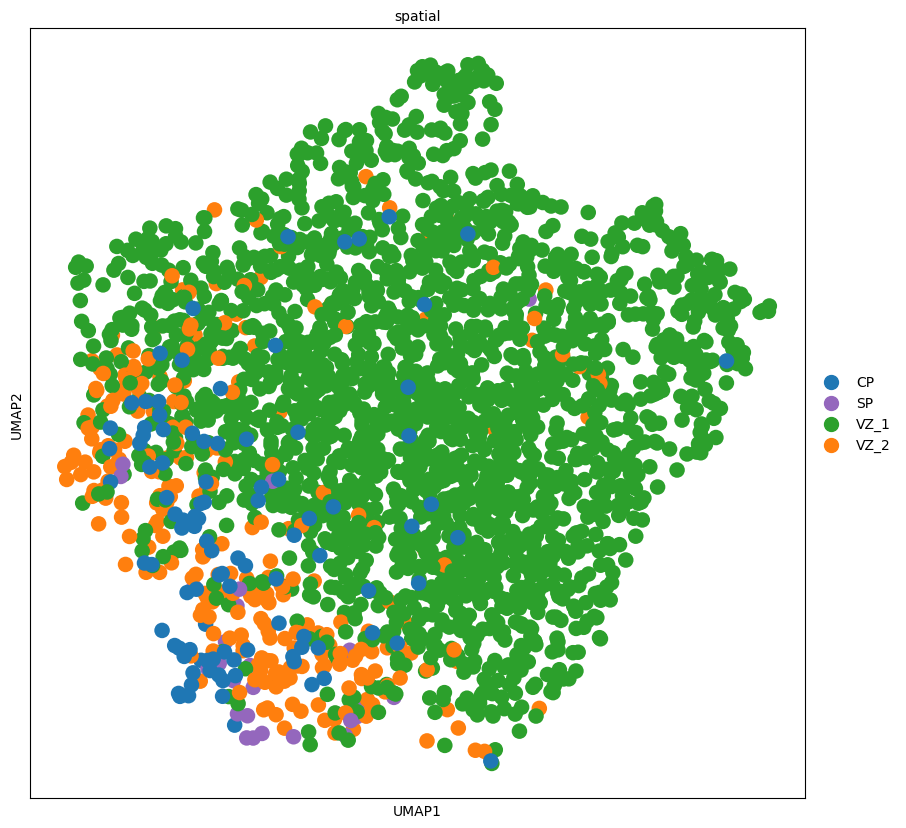

In [615]:
plt.rcParams['figure.figsize'] = 10, 10


sc.pl.umap(
    adata_m,
          color=[
              'spatial',
                ],
    palette=['#1f77b4',"#9467bd",'#2ca02c','#ff7f0e']

    ,
    size=500,
    ncols=1,
    use_raw=False,
    #sc.pl.palettes.vega
 #   add_outline=True
)

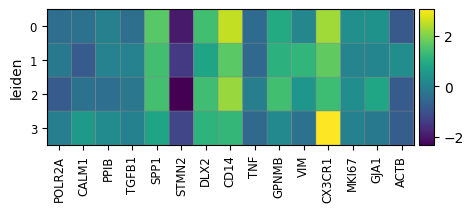

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[4.8, 0, 0.2])

In [611]:
plt.rcParams['font.size'] = 10

sc.pl.matrixplot(adata_m,
                var_names=adata_m.var_names.to_list(),
                groupby='leiden')

In [663]:
df = adata_m.to_df()
df['leiden'] = adata_m.obs.leiden

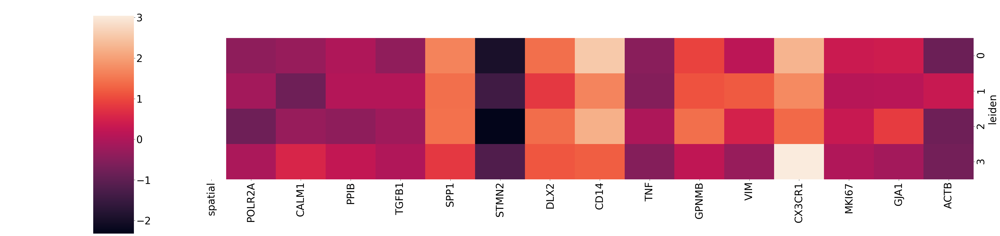

In [666]:
plt.rcParams['font.size'] = 30

sns.clustermap(df.groupby('leiden').mean(),
                    
               col_cluster=False,
                row_cluster=False,
               
               **{'square':True},
     #          row_colors=row_colors,
             #   metric='cityblock' 
               figsize=(42,10),
               cbar_pos=(0.1,0,0.04,0.9),
               row_colors=df__.index.to_series().map(colors)
   
                
                    
              ).savefig("/Users/derekbogdanoff/Desktop/microglia.pdf")


#cg.ax_row_dendrogram.set_visible(False)

In [687]:
sns.__version__

'0.10.1'

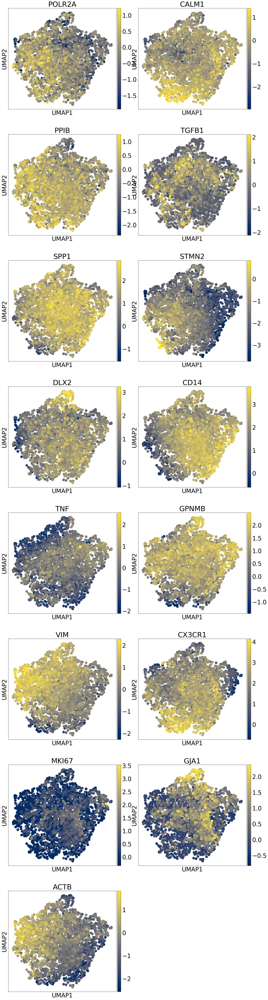

In [365]:
sc.pl.umap(adata_m,
          color=adata_m.var_names.to_list(),
          color_map=mpl.cm.cividis,
          ncols=2,
          s=700)

In [680]:
adata_m.to_df().to_csv('OBI_microglia_Set1.csv')

In [683]:
adata_m.obs.to_csv('OBI_microglia_Set1_annotations.csv')

In [684]:
pwd

'/Users/derekbogdanoff/projects'

In [392]:
from pylab import *

cmap = cm.get_cmap('Dark2', 10)    # PiYG

for i in range(cmap.N):
    rgb = cmap(i)[:3] # will return rgba, we take only first 3 so we get rgb
    print(matplotlib.colors.rgb2hex(rgb))

#1b9e77
#1b9e77
#d95f02
#7570b3
#e7298a
#66a61e
#e6ab02
#a6761d
#666666
#666666


In [56]:
adata_m.to_df()

,POLR2A,CALM1,PPIB,TGFB1,P2RY12,SPP1,STMN2,DLX2,CD14,TNF,GPNMB,VIM,CX3CR1,MKI67,GJA1,CSF1R,MALAT1,ACTB
2771,-0.535048,-0.362633,-1.156738,0.948668,1.629214,1.622784,0.472117,-0.201635,-0.080440,-0.619550,-0.357242,-0.820481,0.988107,-0.011597,-0.508946,1.572837,-0.305843,-0.704277
6557,-1.496281,-1.586902,-0.807211,1.393029,1.805520,1.981146,1.001261,-0.076847,0.452530,-0.271112,-0.636419,-2.251742,0.865775,-1.370733,-0.248494,0.429711,-0.003179,-0.523825
6995,-0.483357,-1.127800,-0.591599,0.272237,0.658671,2.077908,0.818155,-0.211125,-0.075261,-0.177054,-1.085636,0.169118,1.131435,-0.924609,-0.521913,0.835587,-0.285513,-0.414116
7690,-1.492422,-0.860434,0.516010,1.959811,1.598804,1.991768,0.255958,-0.126134,1.118317,0.419527,-0.781686,-2.189012,2.598622,-1.332026,-0.338326,1.911436,-1.087829,-1.294752
8233,-1.503330,-1.508316,-0.060714,0.722683,1.874463,2.065930,-0.017921,-0.048319,-0.266193,-0.184943,0.478507,-0.250432,2.791428,-2.081817,-0.187029,-0.223306,-0.035646,0.258599
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83251,-0.066740,0.128008,0.360200,1.113661,1.444912,1.746056,-0.648060,-0.160710,0.176953,-0.605139,-0.414335,0.447098,1.878927,-0.304752,-0.453025,-0.421701,-0.279529,-0.062764
83447,0.189885,0.232230,-0.048971,0.726259,0.527589,1.298694,-0.188859,-0.061426,-0.266053,-0.265682,-0.604079,1.036151,-0.292672,0.591408,-0.227423,-0.324400,-0.175549,-0.670746
83473,-0.519867,1.337062,0.026005,1.283870,1.654542,1.905216,-1.404786,-0.196239,0.074801,-0.541526,-1.012514,0.891337,0.934215,-0.164966,-0.479088,0.301856,-1.084257,-0.390413
83480,0.811209,-1.086624,-0.507888,1.091641,0.506428,1.297750,-0.232951,-0.209880,-0.552411,-0.546330,-0.352938,0.884028,1.850073,0.160793,-0.497728,0.715818,-0.320708,-0.243322


In [57]:
df___ = adata_m.to_df()

In [59]:
df___['leiden'] = adata_m.obs.leiden

In [74]:
df___

,POLR2A,CALM1,PPIB,TGFB1,P2RY12,SPP1,STMN2,DLX2,CD14,TNF,GPNMB,VIM,CX3CR1,MKI67,GJA1,CSF1R,MALAT1,ACTB,leiden,color
2771,-0.535048,-0.362633,-1.156738,0.948668,1.629214,1.622784,0.472117,-0.201635,-0.080440,-0.619550,-0.357242,-0.820481,0.988107,-0.011597,-0.508946,1.572837,-0.305843,-0.704277,3,#66a61e
6557,-1.496281,-1.586902,-0.807211,1.393029,1.805520,1.981146,1.001261,-0.076847,0.452530,-0.271112,-0.636419,-2.251742,0.865775,-1.370733,-0.248494,0.429711,-0.003179,-0.523825,4,#e7298a
6995,-0.483357,-1.127800,-0.591599,0.272237,0.658671,2.077908,0.818155,-0.211125,-0.075261,-0.177054,-1.085636,0.169118,1.131435,-0.924609,-0.521913,0.835587,-0.285513,-0.414116,1,#7570b3
7690,-1.492422,-0.860434,0.516010,1.959811,1.598804,1.991768,0.255958,-0.126134,1.118317,0.419527,-0.781686,-2.189012,2.598622,-1.332026,-0.338326,1.911436,-1.087829,-1.294752,4,#e7298a
8233,-1.503330,-1.508316,-0.060714,0.722683,1.874463,2.065930,-0.017921,-0.048319,-0.266193,-0.184943,0.478507,-0.250432,2.791428,-2.081817,-0.187029,-0.223306,-0.035646,0.258599,3,#66a61e
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83251,-0.066740,0.128008,0.360200,1.113661,1.444912,1.746056,-0.648060,-0.160710,0.176953,-0.605139,-0.414335,0.447098,1.878927,-0.304752,-0.453025,-0.421701,-0.279529,-0.062764,3,#66a61e
83447,0.189885,0.232230,-0.048971,0.726259,0.527589,1.298694,-0.188859,-0.061426,-0.266053,-0.265682,-0.604079,1.036151,-0.292672,0.591408,-0.227423,-0.324400,-0.175549,-0.670746,0,#d95f02
83473,-0.519867,1.337062,0.026005,1.283870,1.654542,1.905216,-1.404786,-0.196239,0.074801,-0.541526,-1.012514,0.891337,0.934215,-0.164966,-0.479088,0.301856,-1.084257,-0.390413,3,#66a61e
83480,0.811209,-1.086624,-0.507888,1.091641,0.506428,1.297750,-0.232951,-0.209880,-0.552411,-0.546330,-0.352938,0.884028,1.850073,0.160793,-0.497728,0.715818,-0.320708,-0.243322,3,#66a61e


In [103]:
colors_m = {'0':'#d95f02','1':'#7570b3','2':'#e6ab02','3':'#66a61e','4':'#e7298a'}


In [104]:
type(colors_m)

dict

In [71]:
df___['color'] = df___.leiden.map(colors_m)

In [93]:
df___.color

2771     #66a61e
6557     #e7298a
6995     #7570b3
7690     #e7298a
8233     #66a61e
          ...   
83251    #66a61e
83447    #d95f02
83473    #66a61e
83480    #66a61e
83567    #66a61e
Name: color, Length: 1648, dtype: category
Categories (5, object): [#d95f02, #7570b3, #e6ab02, #66a61e, #e7298a]

In [94]:
df____ = df___.groupby('leiden').mean()

In [95]:
df____.index.to_series().map(colors_m)

leiden
0    #d95f02
1    #7570b3
2    #e6ab02
3    #66a61e
4    #e7298a
Name: leiden, dtype: category
Categories (5, object): [#d95f02, #7570b3, #e6ab02, #66a61e, #e7298a]

In [187]:
adata.var_names.tolist()

['POLR2A',
 'CALM1',
 'PPIB',
 'TGFB1',
 'P2RY12',
 'SPP1',
 'STMN2',
 'DLX2',
 'CD14',
 'TNF',
 'GPNMB',
 'VIM',
 'CX3CR1',
 'MKI67',
 'GJA1',
 'CSF1R',
 'MALAT1',
 'ACTB']

In [98]:
iris = sns.load_dataset("iris")
species = iris.pop("species")

In [105]:
species

0         setosa
1         setosa
2         setosa
3         setosa
4         setosa
         ...    
145    virginica
146    virginica
147    virginica
148    virginica
149    virginica
Name: species, Length: 150, dtype: object

In [111]:
adata_m.obs.leiden.unique(), []

[3, 4, 1, 2, 0]
Categories (5, object): [3, 4, 1, 2, 0]

In [ ]:
['#d95f02','#7570b3','#e6ab02','#66a61e','#e7298a']

5        1
8        1
9        1
11       1
12       1
        ..
84455    0
84456    0
84457    0
84459    0
84460    0
Name: leiden, Length: 39102, dtype: category
Categories (3, object): [0, 1, 2]

In [127]:
lut_m = dict(zip(adata_m.obs.leiden.unique(), ['#d95f02','#7570b3','#e6ab02','#66a61e','#e7298a']))

In [128]:
lut_m

{'3': '#d95f02',
 '4': '#7570b3',
 '1': '#e6ab02',
 '2': '#66a61e',
 '0': '#e7298a'}

In [144]:
df=pd.DataFrame(['#d95f02','#7570b3','#e6ab02','#66a61e','#e7298a'])

In [148]:
df=df.astype('category')

In [138]:
species_m = adata_m.obs.leiden

In [139]:
row_colors = species_m.map(lut_m)

In [122]:
adata_m.obs

0      r
1      r
2      r
3      r
4      r
      ..
145    g
146    g
147    g
148    g
149    g
Name: species, Length: 150, dtype: object

/Users/derekbogdanoff/projects/venv3/lib/python3.8/site-packages/seaborn/matrix.py:1201: UserWarning: ``square=True`` ignored in clustermap
  warnings.warn(msg)


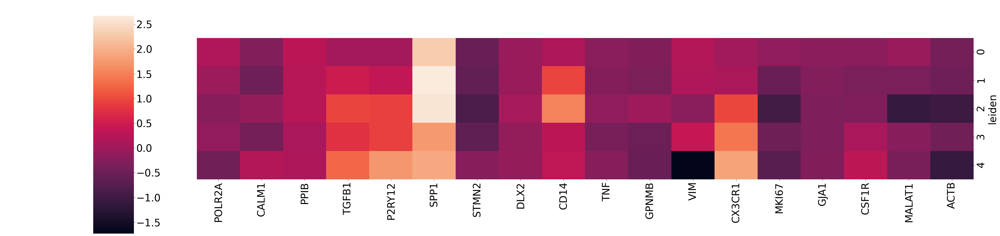

In [171]:
plt.rcParams['font.size'] = 30

sns.clustermap(
                
                df____, #.groupby('leiden').mean(),
                    
               col_cluster=False,
                row_cluster=False,
               
               **{'square':True},
     #          row_colors=row_colors,
             #   metric='cityblock' 
               figsize=(42,10),
               cbar_pos=(0.1,0,0.04,0.9),
    
    
    
         #      row_colors=row_colors    #df____.index.to_series().map(colors_m)
   
                
                    
              ).savefig("/Users/derekbogdanoff/Desktop/microglia.pdf")




#cg.ax_row_dendrogram.set_visible(False)

In [50]:
adata_m.obs

,x_pos,y_pos,perimeter,n_counts,n_genes,log_counts,leiden,color
2771,7276.0,43150.0,266.8,194.0,15.0,2.287802,3,#66a61e
6557,9005.0,24942.0,455.7,88.0,11.0,1.944483,4,#e7298a
6995,7563.0,19791.0,678.5,178.0,15.0,2.250420,1,#7570b3
7690,13013.0,20500.0,638.1,84.0,12.0,1.924279,4,#e7298a
8233,14076.0,25263.0,672.7,57.0,10.0,1.755875,3,#66a61e
...,...,...,...,...,...,...,...,...
83251,77297.0,45373.0,583.7,263.0,15.0,2.419956,3,#66a61e
83447,78283.0,48047.0,98.9,114.0,11.0,2.056905,0,#d95f02
83473,78461.0,48317.0,371.6,124.0,14.0,2.093422,3,#66a61e
83480,78491.0,48160.0,364.6,101.0,14.0,2.004321,3,#66a61e


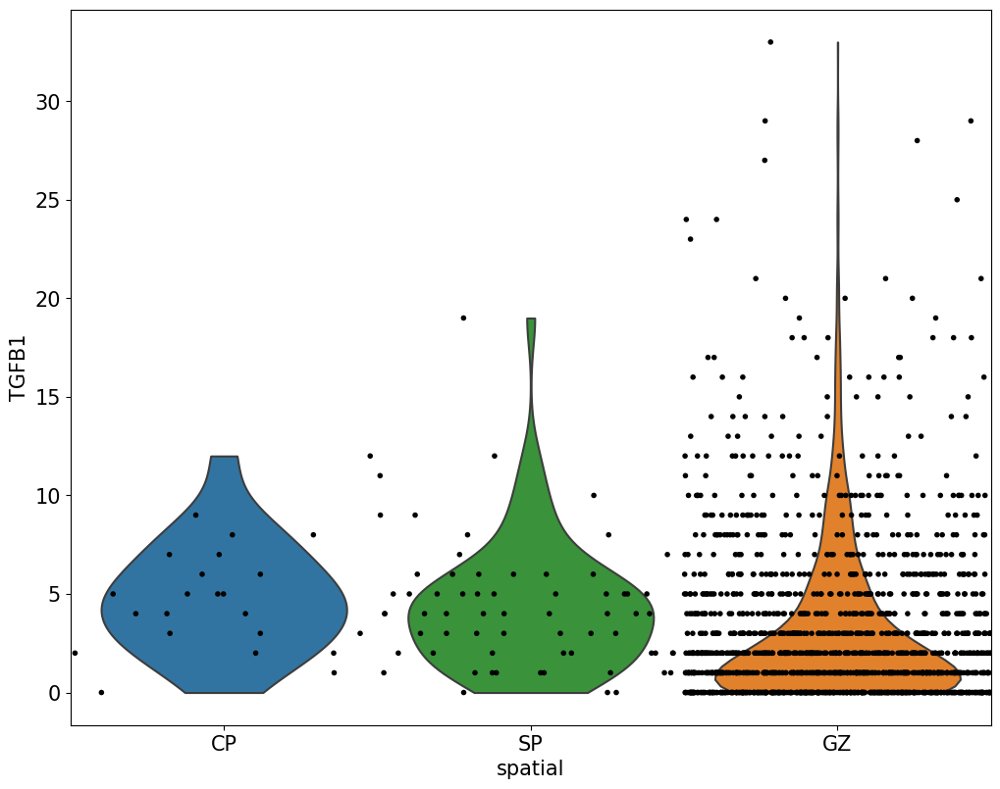

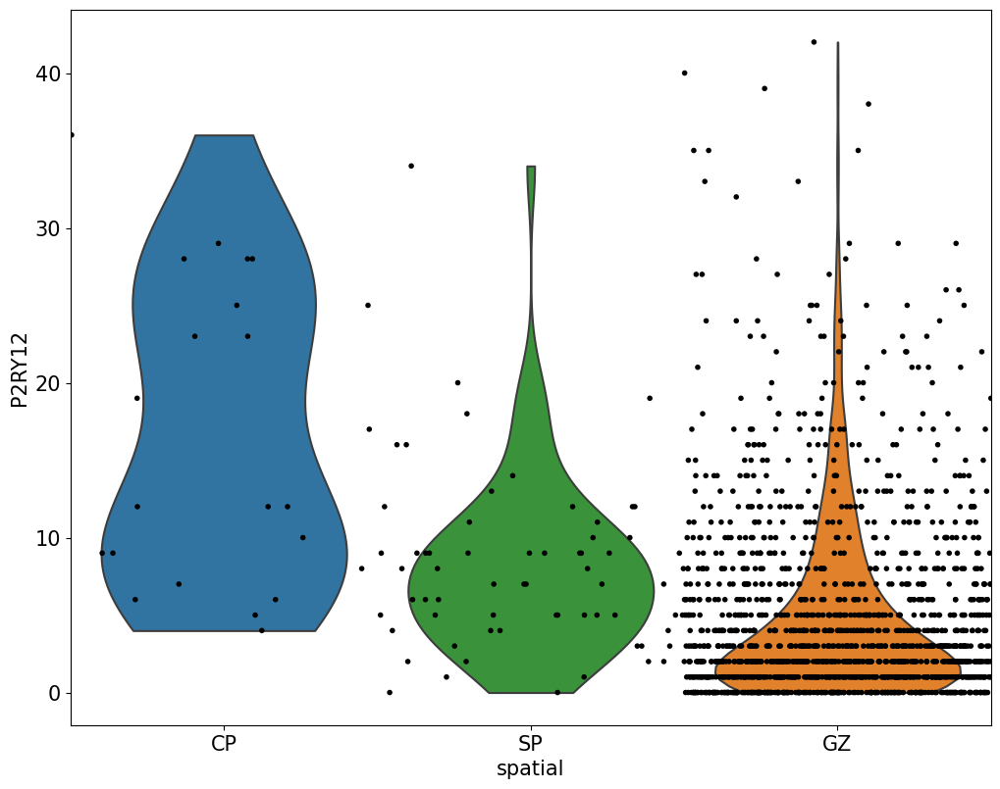

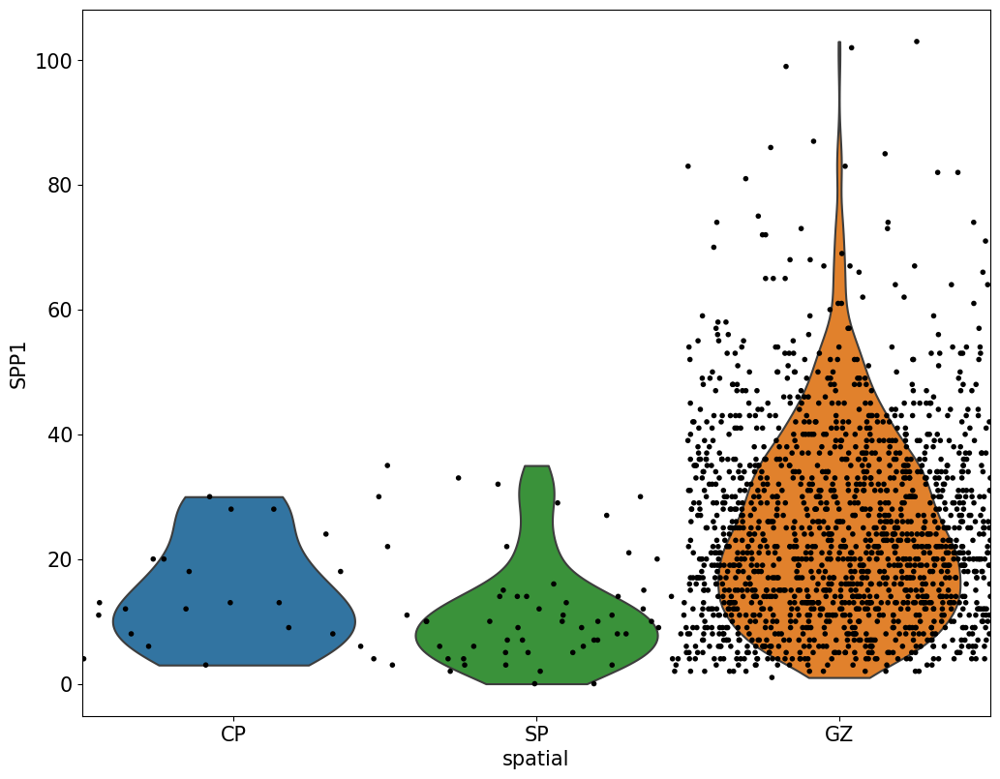

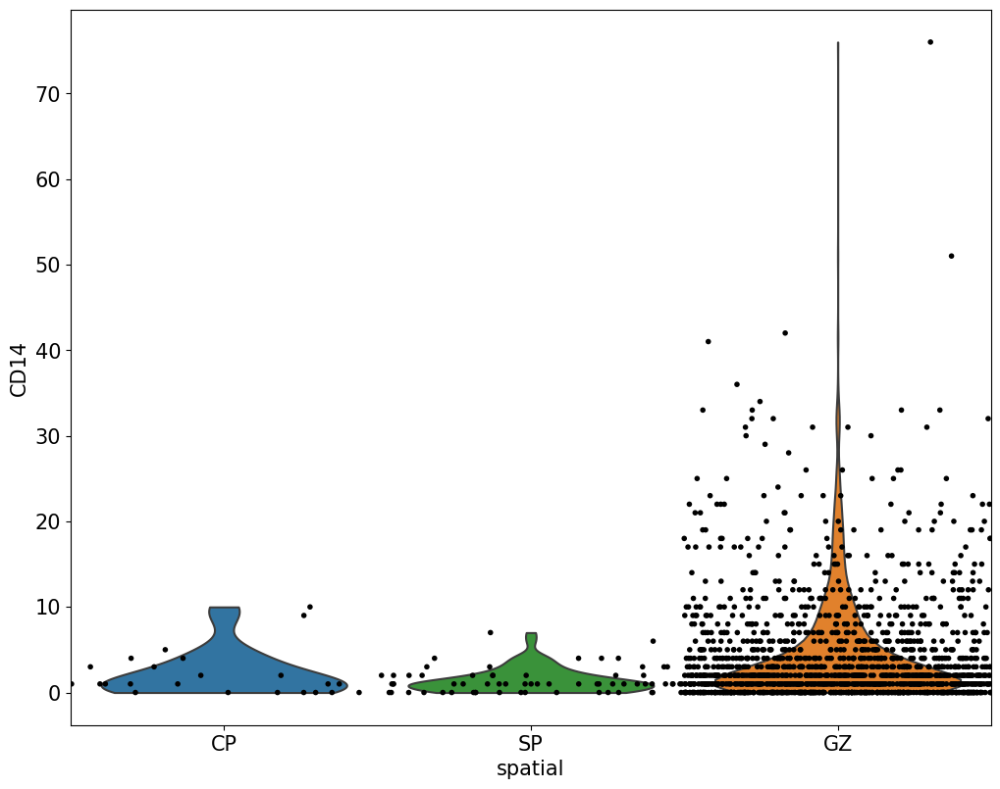

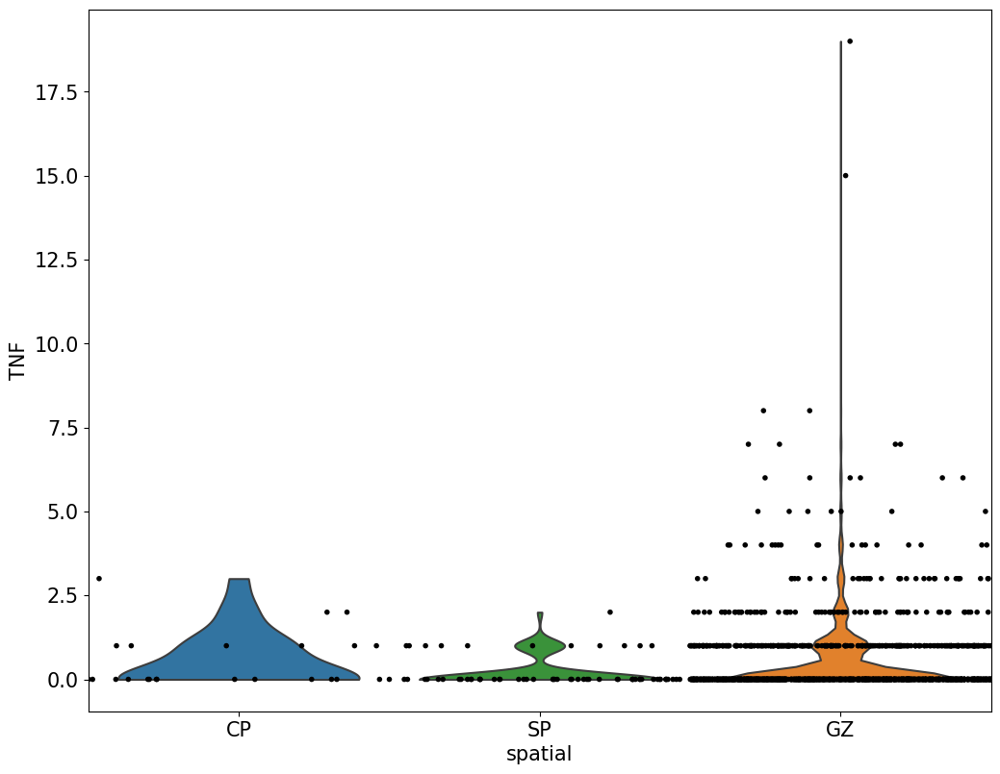

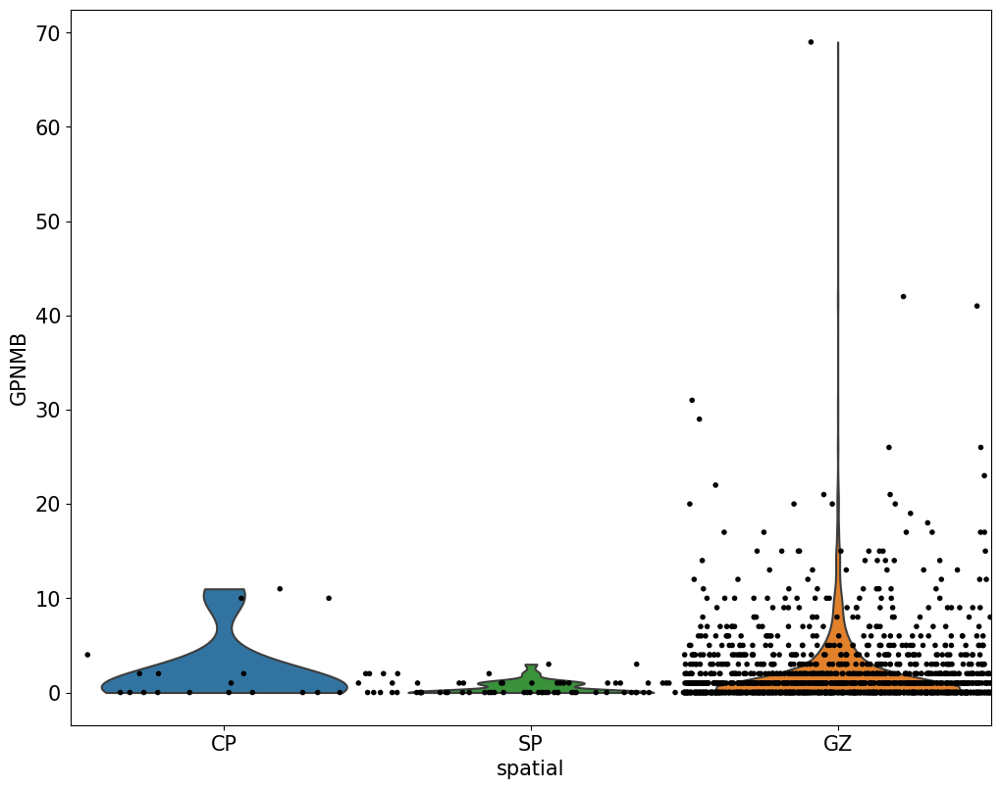

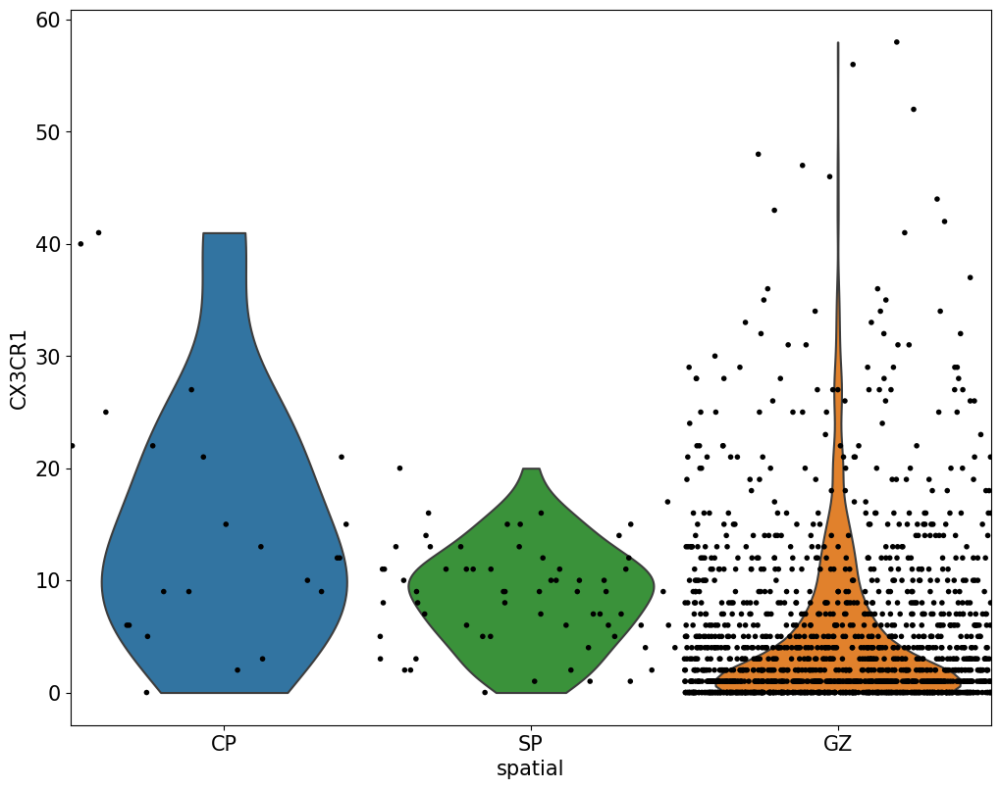

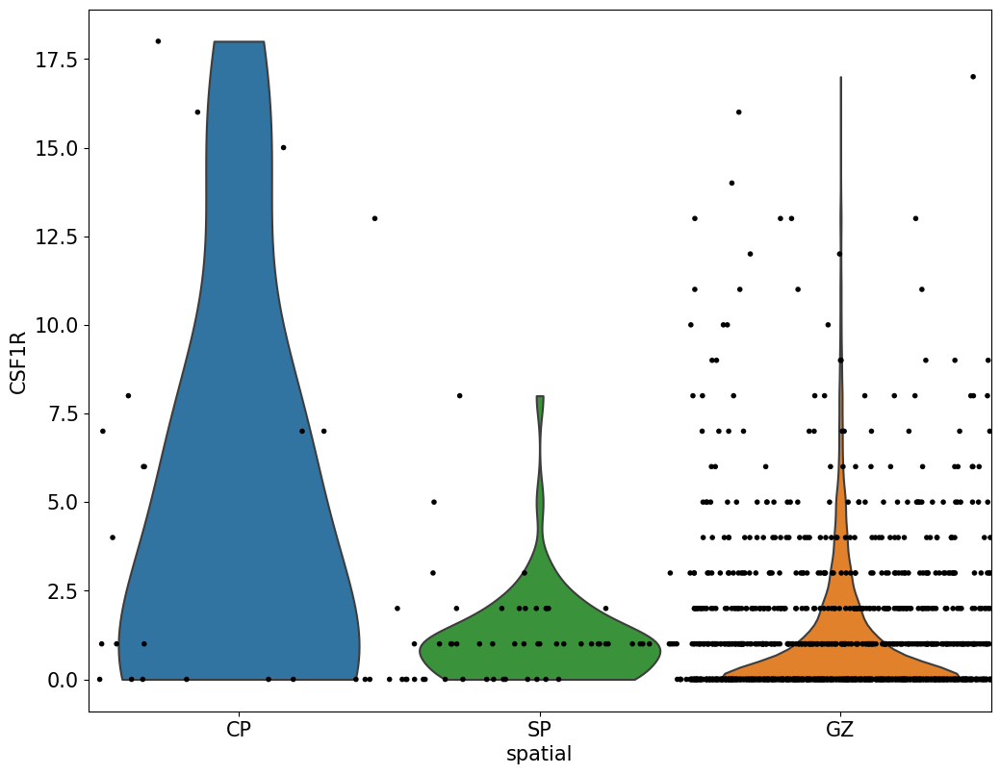

In [334]:


plt.rcParams['figure.figsize'] = 10,10
plt.rcParams['font.size'] = 15

for i in ['TGFB1', 'P2RY12', 'SPP1', 'CD14', 'TNF', 'GPNMB', 'CX3CR1', 'CSF1R']:
    sc.pl.violin(adata_m,
            groupby='spatial',
            keys=[i],
            stripplot=True,
                 #jitter=True,
            **{"jitter":0.5},
            size=4,

                 
                 
#            **{"palette":['#fbb4ae',"#b3cde3",'#decbe4']},
           **{"order":['CP','SP','GZ']},
                 use_raw=True,
                 
                 
            )

In [37]:
adata_m

AnnData object with n_obs × n_vars = 1648 × 18
    obs: 'x_pos', 'y_pos', 'perimeter', 'n_counts', 'n_genes', 'log_counts', 'leiden', 'color'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [631]:
adata_m.uns['leiden_colors'] = [
'#1b9e77',
'#d95f02',
'#7570b3',
'#e6ab02',
     ] 

In [632]:
df=pd.DataFrame(adata_m.uns['leiden_colors'],columns=['color'])
df['leiden'] = adata_m.obs.leiden.cat.categories

df2 = pd.DataFrame(adata_m.obs.leiden)#merge(df, on='leiden')
df2=df2.merge(df, on='leiden', how='left')

df2.index = adata_m.obs.index
adata_m.obs['color'] = df2['color']

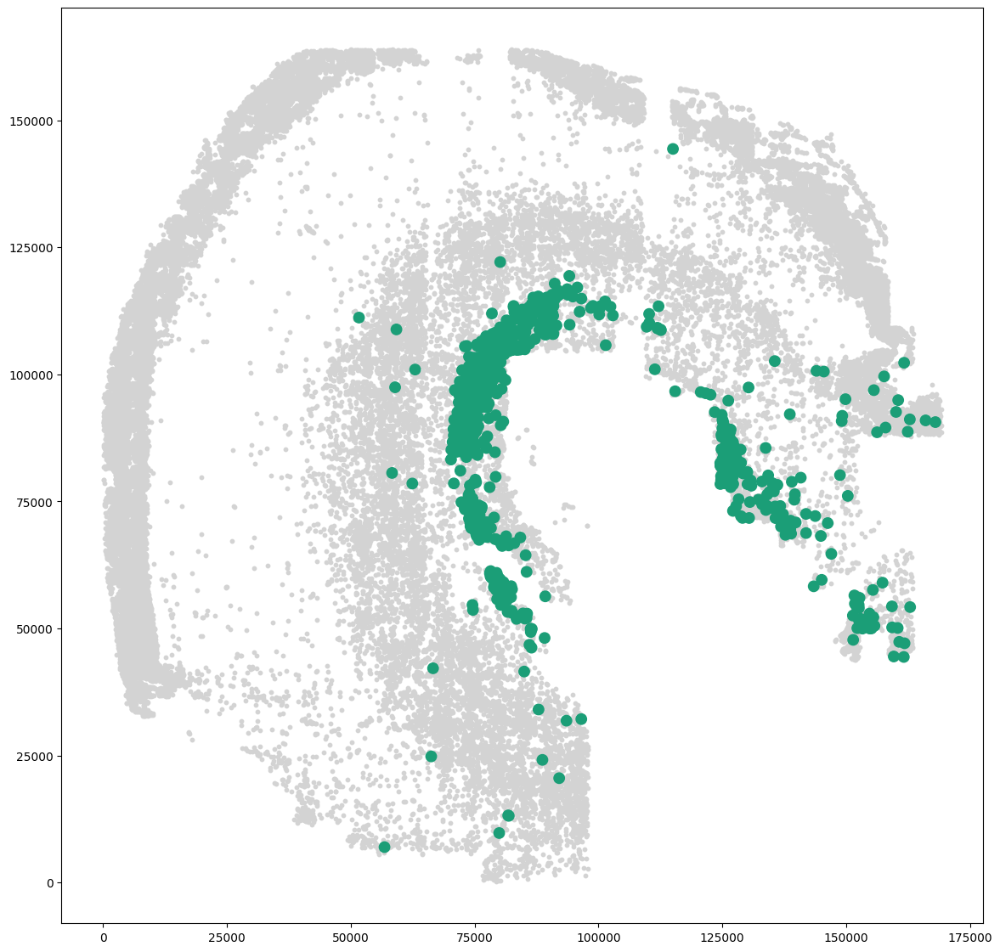

In [637]:
plt.figure(figsize=[14,14])

plt.rcParams['axes.facecolor'] = 'white'

plt.scatter(x=adata.obs.x_pos,
            y=adata.obs.y_pos,
            c='lightgrey',
            s=10,
      
         #   edgecolors='white'
            
            
            
#              )

# plt.scatter(x=adata_m.obs.x_pos,
#             y=adata_m.obs.y_pos,
#              c=adata_m.obs.color,
#             s=80,
                    
                    
#          #   edgecolors='white'
            
#            )          
             
            
           )
plt.scatter(x=adata_m[adata_m.obs.leiden == '0'].obs.x_pos,
            y=adata_m[adata_m.obs.leiden == '0'].obs.y_pos,
            c=adata_m[adata_m.obs.leiden == '0'].obs.color,
            s=80,
                    
                    
         #   edgecolors='white'
            
           )




# plt.scatter(x=adata_m[adata_m.obs.leiden == '4'].obs.x_pos,
#             y=adata_m[adata_m.obs.leiden == '4'].obs.y_pos,
#              c=adata_m[adata_m.obs.leiden == '4'].obs.color,
#             s=80,
                    
                    
#          #   edgecolors='white'
            
#            )

... storing 'color' as categorical


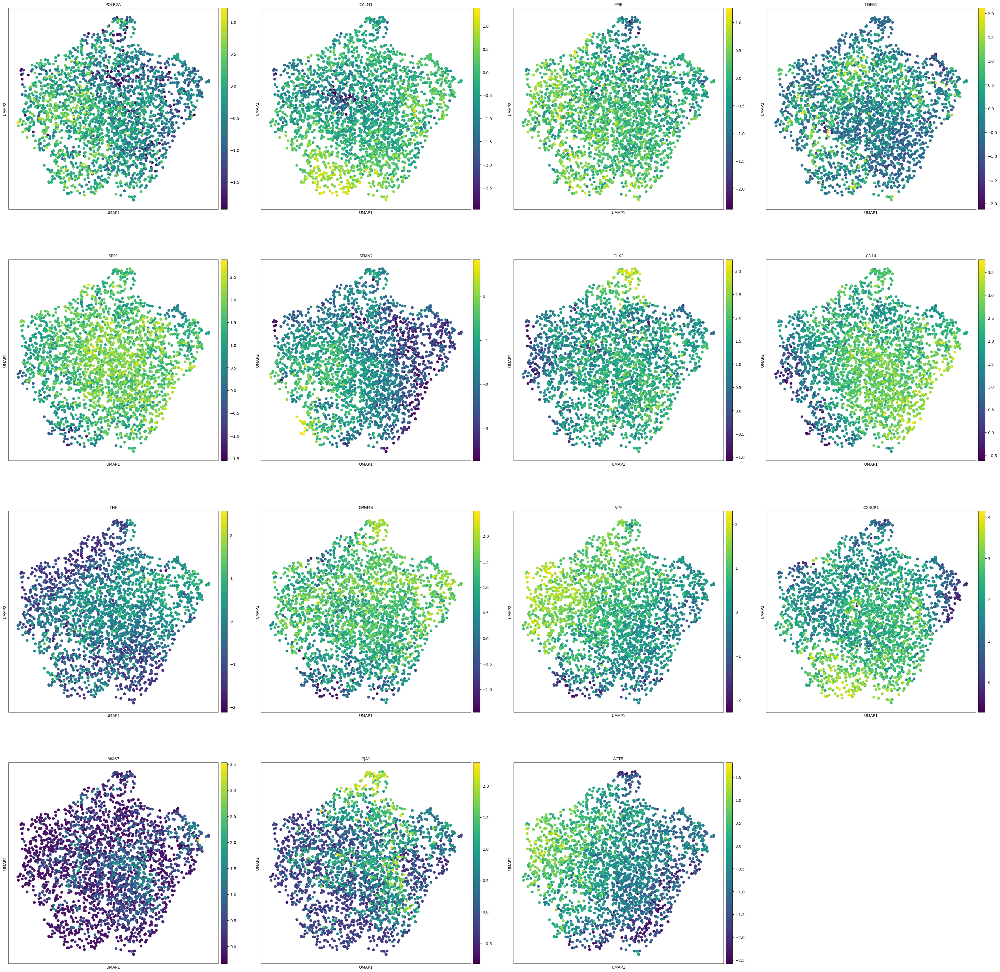

In [638]:
plt.rcParams['figure.figsize'] = 10, 10


sc.pl.umap(
    adata_m,
          color=adata.var_names.to_list(),
    palette="Set3",
    size=200,
    ncols=4,
    use_raw=False,
    #sc.pl.palettes.vega
)